In [1]:
import xarray as xr
import dask
import numpy as np
from datetime import datetime, timedelta
from cartopy.feature.nightshade import Nightshade
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import os, glob, sys, gc
import tqdm.auto as tqdm
import pandas as pd

/glade/work/abukowski/conda-envs/SAMI3-GITM/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import argparse
import glob
import os
from datetime import timedelta

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec7877
import matplotlib.colors as colors

import numpy as np
import xarray as xr

import importlib


In [3]:
os.chdir('SAMI3-GITM-python/')

In [4]:
import utility_programs.filters as filters
from utility_programs.plotting_routines import panel_plot
from utility_programs.read_routines.GITM import auto_read as auto_read_gitm
from utility_programs.read_routines.GITM import gitm_times_from_filelist
from utility_programs.read_routines.SAMI import auto_read as auto_read_sami
from utility_programs import plotting_routines
from utility_programs.utils import ut_to_lt

/glade/u/home/abukowski/SAMI3-GITM-python/utility_programs/plotting_routines.py:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))


# Read in all Rot B Datasets:

In [57]:
gitms = {}
samis = {}

for file in np.sort(glob.glob('/glade/u/home/abukowski/scratch/postprocessed/*')):
    if 'rotB' in file:
        relevant = file[file.find('rotB-'):]
        bz = relevant.split('_')[0].split('-')[1:]
        
        if len(bz) == 1:
            if 'GITM' in file:
                if len(gitms.keys()) > 0:
                    with dask.config.set(**{'array.slicing.split_large_chunks': True}):
                        gitms['-'.join(bz)] = xr.open_mfdataset(file).reindex_like(gitms[gitm_key0], method='nearest')
                else:
                    gitms['-'.join(bz)] = xr.open_mfdataset(file)
                    gitm_key0 = '-'.join(bz)
            elif 'SAMI' in file:
                samis['-'.join(bz)] = xr.open_mfdataset(file)
            else:
                print('file %s error' %file)
        
        elif len(bz) == 2:
            if 'GITM' in file:
                if len(gitms.keys()) > 0:
                    with dask.config.set(**{'array.slicing.split_large_chunks': True}):
                        gitms['-'.join(bz)] = xr.open_mfdataset(file).reindex_like(gitms[gitm_key0], method='nearest')
                else:
                    gitms['-'.join(bz)] = xr.open_mfdataset(file)
                    gitm_key0 = '-'.join(bz)
            elif 'SAMI' in file:
                samis['-'.join(bz)] = xr.open_mfdataset(file)
            else:
                print('file %s error' %file)            
        


In [80]:
gitms['bz17'].AltIntCO2Cooling_W_m2.values.flatten()[:30]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

# First look at Altitude Integrated Joule Heating for the GITM runs:

In [52]:
plotting_routines = importlib.reload(plotting_routines)

/glade/u/home/abukowski/SAMI3-GITM-python/utility_programs/plotting_routines.py:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))


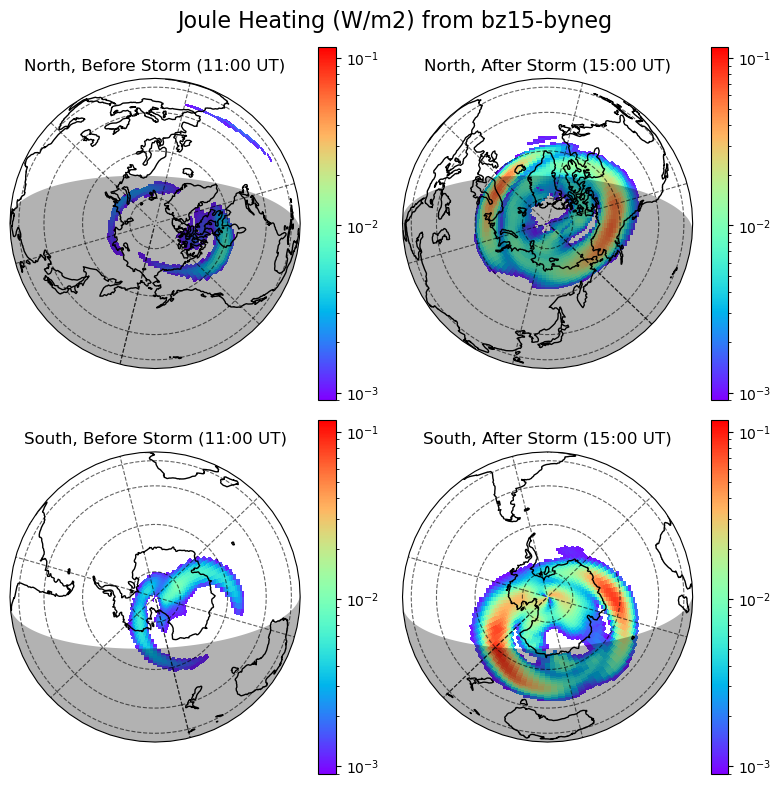

In [26]:
plotting_routines.loop_panels(gitms[storm].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from ' + storm,
                start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
                col_names = ['Before', 'After'], cmap='rainbow', mask_dials = .001,
                                      norm=colors.LogNorm(
                                          vmin = .0009, 
                    vmax = gitms[storm].AltIntJouleHeating_W_m2.max().values))

dict_keys(['bz15-byneg', 'bz15-bypos', 'bz17', 'bz8-byneg', 'bz8-bypos'])

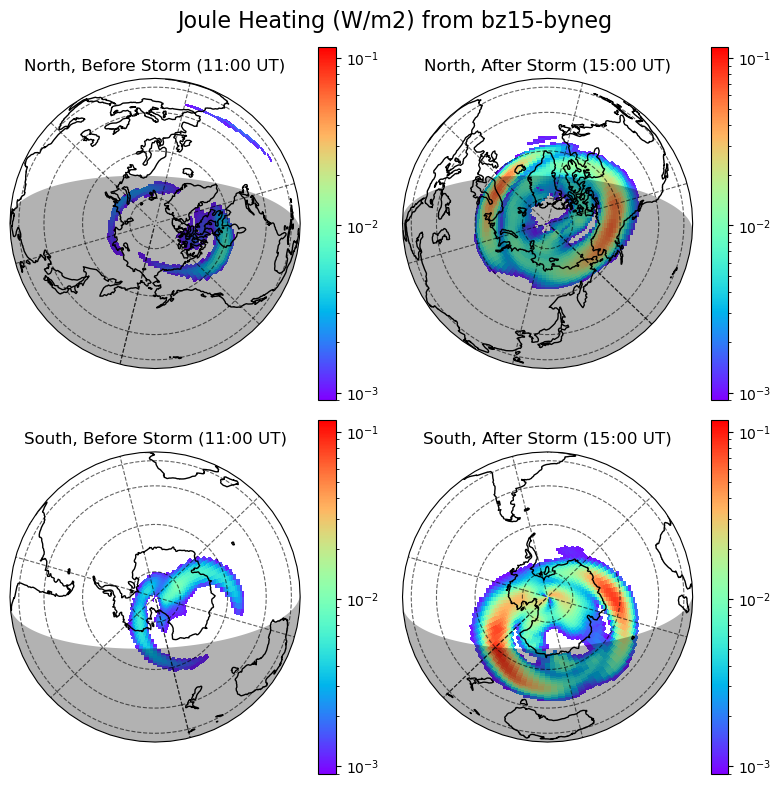

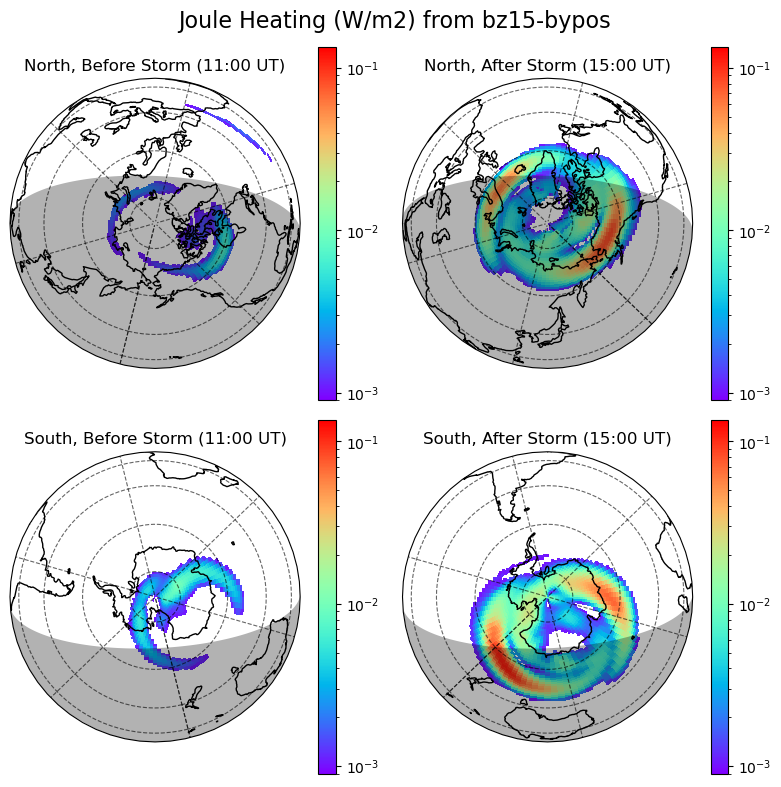

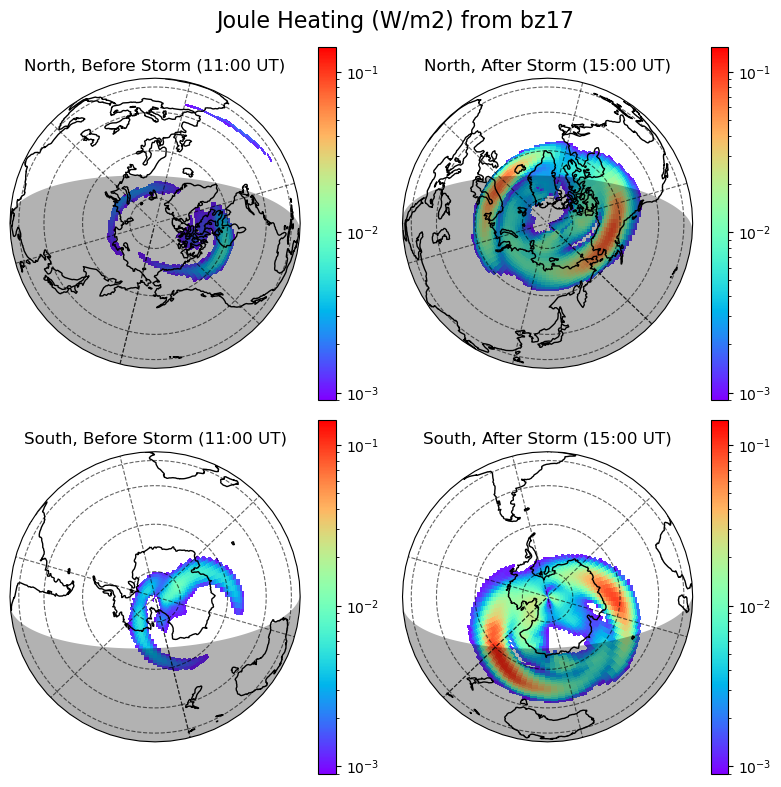

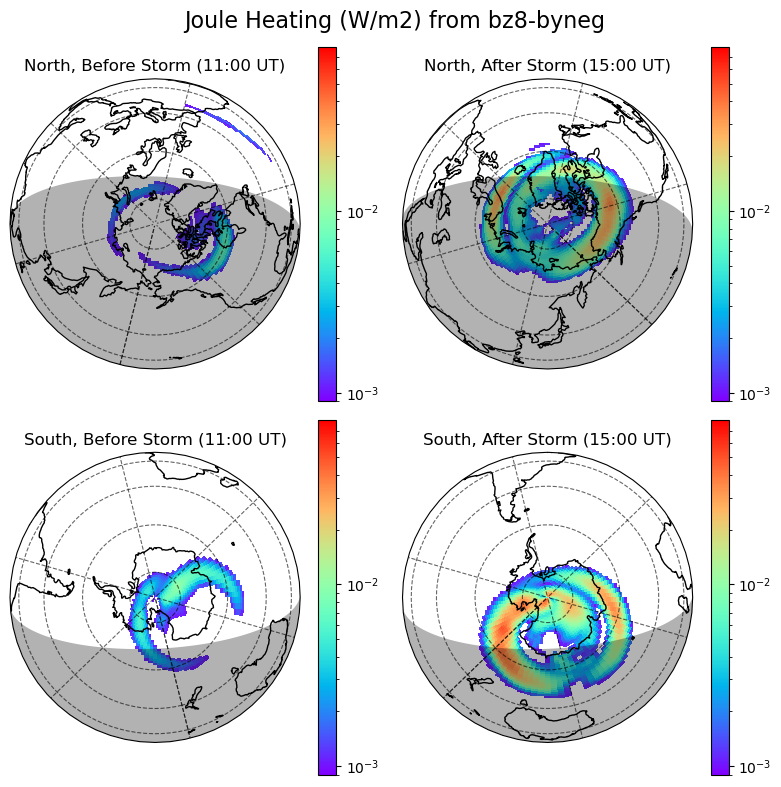

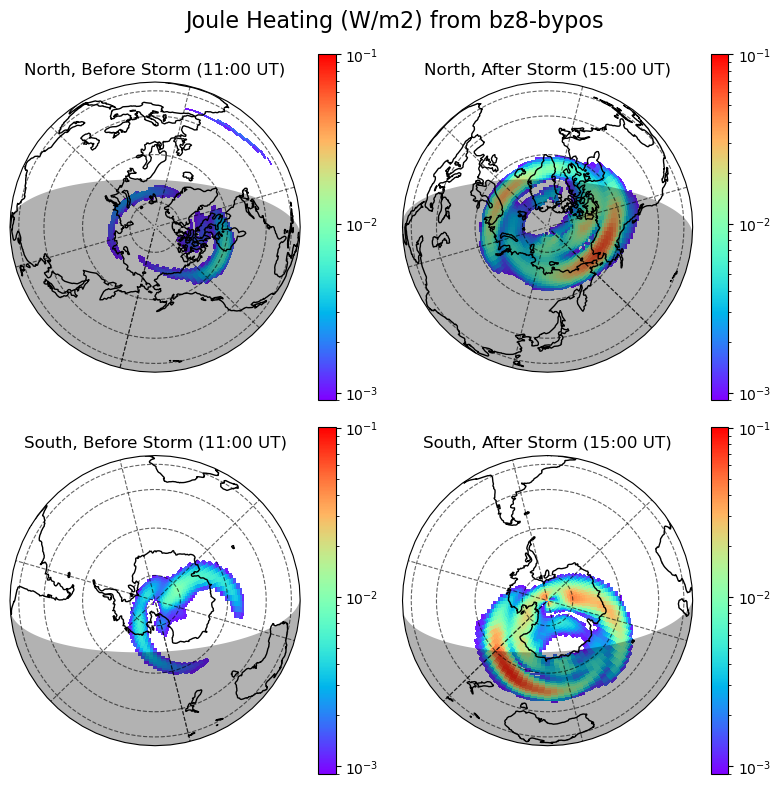

In [34]:
i=0

for storm in gitms.keys():
    # if '15' in storm or '17' in storm:
#         plotting_routines.loop_panels(gitms[storm].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from ' + storm,
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'After'], cmap='rainbow', save='/glade/u/home/abukowski/1.png')

#         plotting_routines.loop_panels(gitms[storm].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from ' + storm,
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'After'], cmap='rainbow', vmax = gitms[storm].AltIntJouleHeating_W_m2.max().values, save='/glade/u/home/abukowski/2.png')

        plotting_routines.loop_panels(gitms[storm].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from ' + storm,
                start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
                col_names = ['Before', 'After'], cmap='rainbow', mask_dials=0.001,
                                      norm=colors.LogNorm(
                                          vmin = .0009, 
                    vmax = gitms[storm].AltIntJouleHeating_W_m2.max().values), save='/glade/u/home/abukowski/plots/cedar/exploring/rotB/JH/before-after/%s'%storm)
        i+=1
        # break

In [35]:
# _ = plotting_routines.loop_panels(gitms['bz15-bypos'].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from bz15 (bypos)',
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', norm=colors.LogNorm(
#                     vmin = .0009,
#                     vmax = gitms['bz15-bypos'].AltIntJouleHeating_W_m2.max().values), save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz15-bypos-before-during')

# _ = plotting_routines.loop_panels(gitms['bz15-byneg'].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from bz15 (byneg)',
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', norm=colors.LogNorm(
#                     vmin = .0009,
#                     vmax = gitms['bz15-byneg'].AltIntJouleHeating_W_m2.max().values),
#                              save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz15-byneg-before-during')

# _ = plotting_routines.loop_panels((gitms['bz15-bypos'].AltIntJouleHeating_W_m2 
#                                - gitms['bz15-byneg'].AltIntJouleHeating_W_m2.reindex_like(
#                                    gitms['bz15-bypos'], method='nearest')),
#                               ncols=2, title='Joule Heating (W/m2) difference between bz15 runs (bypos-byneg)',
#         start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#         col_names = ['Before', 'During'], cmap='rainbow', vmin = -.03, vmax=.03,
#                              save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz15-ByDiffs')



In [36]:
# _ = plotting_routines.loop_panels(gitms['bz8-bypos'].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from bz8 (bypos)',
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', norm=colors.LogNorm(
#                     vmin = .0009,
#                     vmax = gitms['bz8-bypos'].AltIntJouleHeating_W_m2.max().values), save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz8-bypos-before-during')

# _ = plotting_routines.loop_panels(gitms['bz8-byneg'].AltIntJouleHeating_W_m2, ncols=2, title='Joule Heating (W/m2) from bz8 (byneg)',
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', norm=colors.LogNorm(
#                     vmin = .0009,
#                     vmax = gitms['bz8-byneg'].AltIntJouleHeating_W_m2.max().values),
#                              save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz8-byneg-before-during')

# _ = plotting_routines.loop_panels((gitms['bz8-bypos'].AltIntJouleHeating_W_m2 
#                                - gitms['bz8-byneg'].AltIntJouleHeating_W_m2.reindex_like(
#                                    gitms['bz8-bypos'], method='nearest')),
#                               ncols=2, title='Joule Heating (W/m2) difference between bz8 runs (bypos-byneg)',
#         start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#         col_names = ['Before', 'During'], cmap='rainbow', vmin = -.03, vmax=.03,
#                              save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz8-ByDiffs')



In [37]:
# _ = plotting_routines.loop_panels((gitms['bz17'].AltIntJouleHeating_W_m2 
#                                - gitms[k].AltIntJouleHeating_W_m2.reindex_like(
#                                    gitms['bz17'], method='nearest')
                                   
#                                    , ncols=2, title='Joule Heating (W/m2) diff between %s and bz17' %k,
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', norm=colors.LogNorm(
#                     vmin = .0009,
#                     vmax = .003)
#                                    , save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz17-before-during')

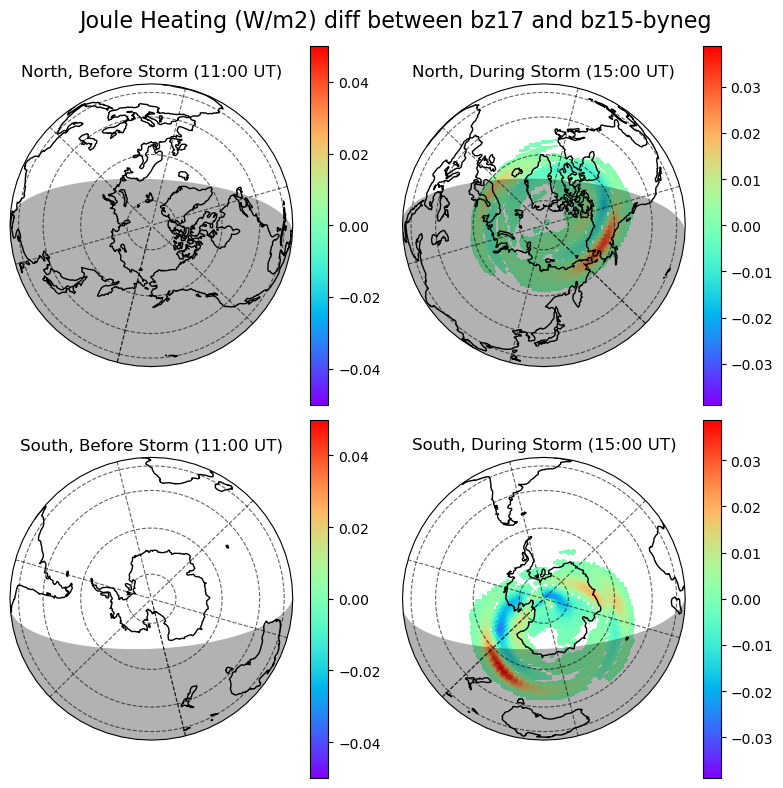

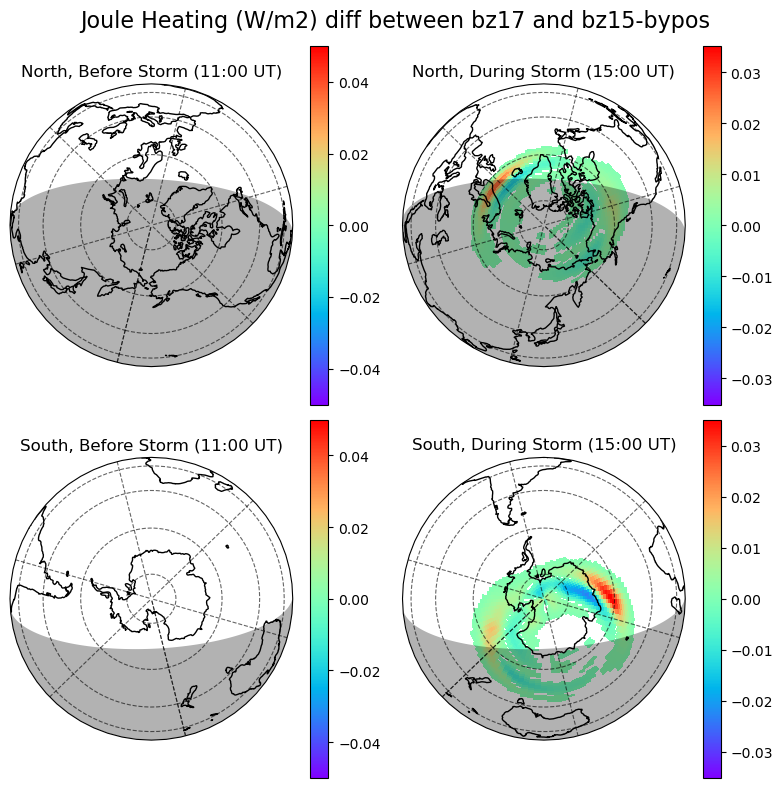

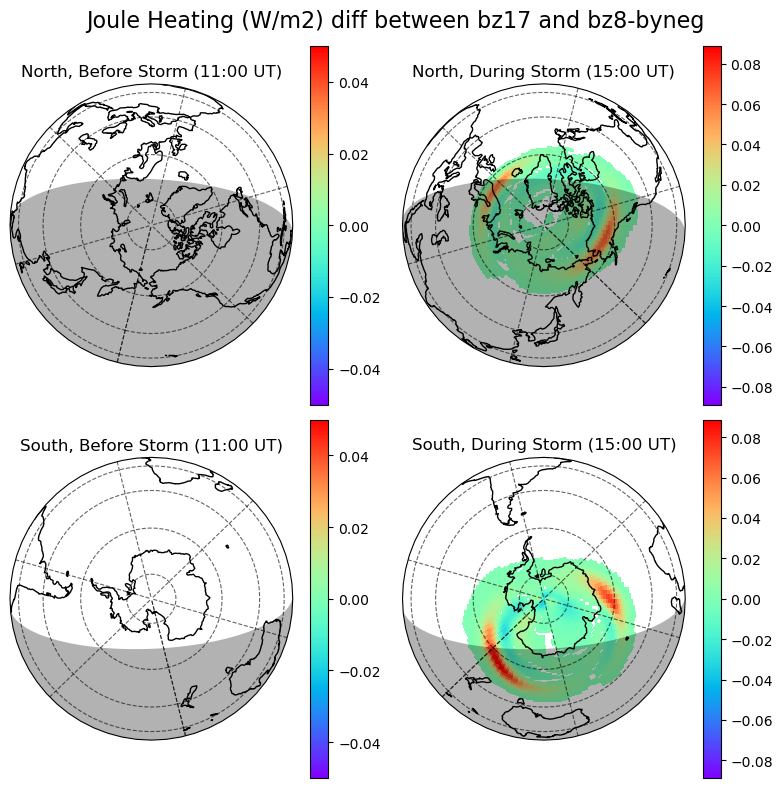

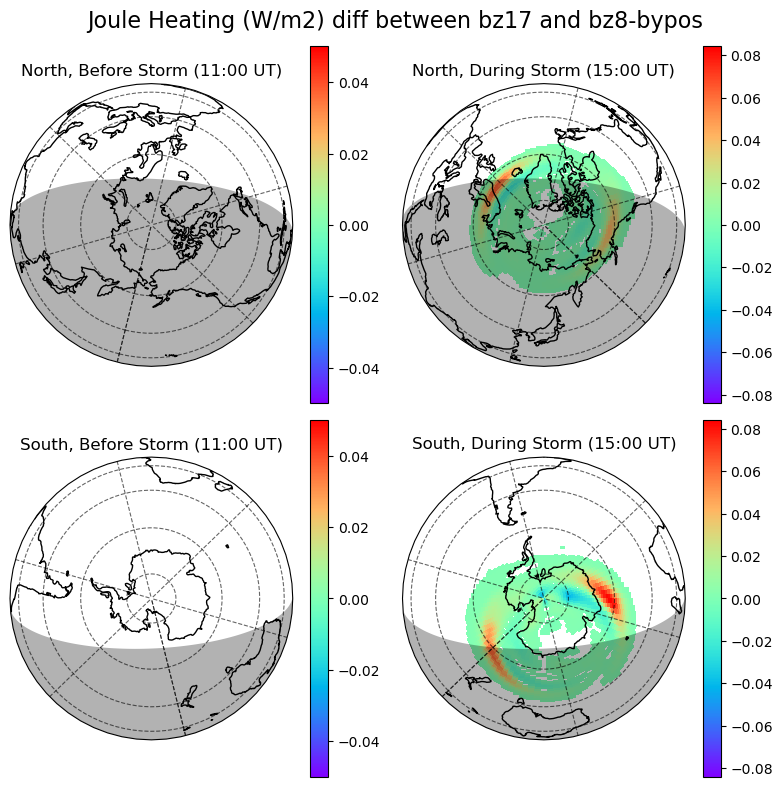

In [47]:
for k in gitms.keys():
    if '17' not in k:

        _ = plotting_routines.loop_panels((gitms['bz17'].AltIntJouleHeating_W_m2
                                           - gitms[k].AltIntJouleHeating_W_m2.reindex_like(
                                           gitms['bz17'], method='nearest')),
                                          ncols=2, title='Joule Heating (W/m2) diff between bz17 and %s' % k,
                                          start_time=pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours',
                                          mask_dials=0.0005,
                                          col_names=['Before', 'During'], cmap='rainbow', save='/glade/u/home/abukowski/plots/cedar/exploring/rotB/JH/diff-from-bz17/%s' % k)

In [48]:
# for k in gitms.keys():
#     if '17' not in k:
#         _ = plotting_routines.loop_panels(gitms['bz17'].AltIntJouleHeating_W_m2, ncols=2,
#                                           title='Joule Heating (W/m2) Difference from Full Bz (bz17 - %s)' %k,
#                 start_time= pd.Timestamp('2011-11-21 11:00'), time_delta='4 hours', 
#                 col_names = ['Before', 'During'], cmap='rainbow', vmin = -.03, vmax = .03,
#                                           save='/glade/u/home/abukowski/plots/cedar-drafts/rotB/JH/bz17-%s_DIFF_before-during' %k)
#         plt.close('all')

In [49]:
list(gitms['bz17'].data_vars)

['LocalTime',
 'SolarZenithAngle',
 'VerticalTEC',
 'AltIntJouleHeating_W_m2',
 'AltIntHeatingTransfer_W_m2',
 'AltIntEuvHeating_W_m2',
 'AltIntPhotoElectronHeating_W_m2',
 'AltIntChamicalHeating_W_m2',
 'AltIntRadCooling_W_m2',
 'AltIntCO2Cooling_W_m2',
 'AltIntNOCooling_W_m2',
 'AltIntOCooling_W_m2',
 'Rho',
 'O_3P',
 'O2',
 'N2',
 'N_4S',
 'NO',
 'He',
 'N_2D',
 'N_2P',
 'H',
 'CO2',
 'O_1D',
 'Temperature',
 'Vn_east',
 'Vn_north',
 'Vn_up',
 'Vn_up_O_3P',
 'Vn_up_O2',
 'Vn_up_N2',
 'Vn_up_N_4S',
 'Vn_up_NO',
 'Vn_up_He',
 'O_4SP_plus',
 'NO_plus',
 'O2_plus',
 'N2_plus',
 'N_plus',
 'O_2D_plus',
 'O_2P_plus',
 'H_plus',
 'He_plus',
 'e_',
 'eTemperature',
 'iTemperature',
 'Vi_east',
 'Vi_north',
 'Vi_up']

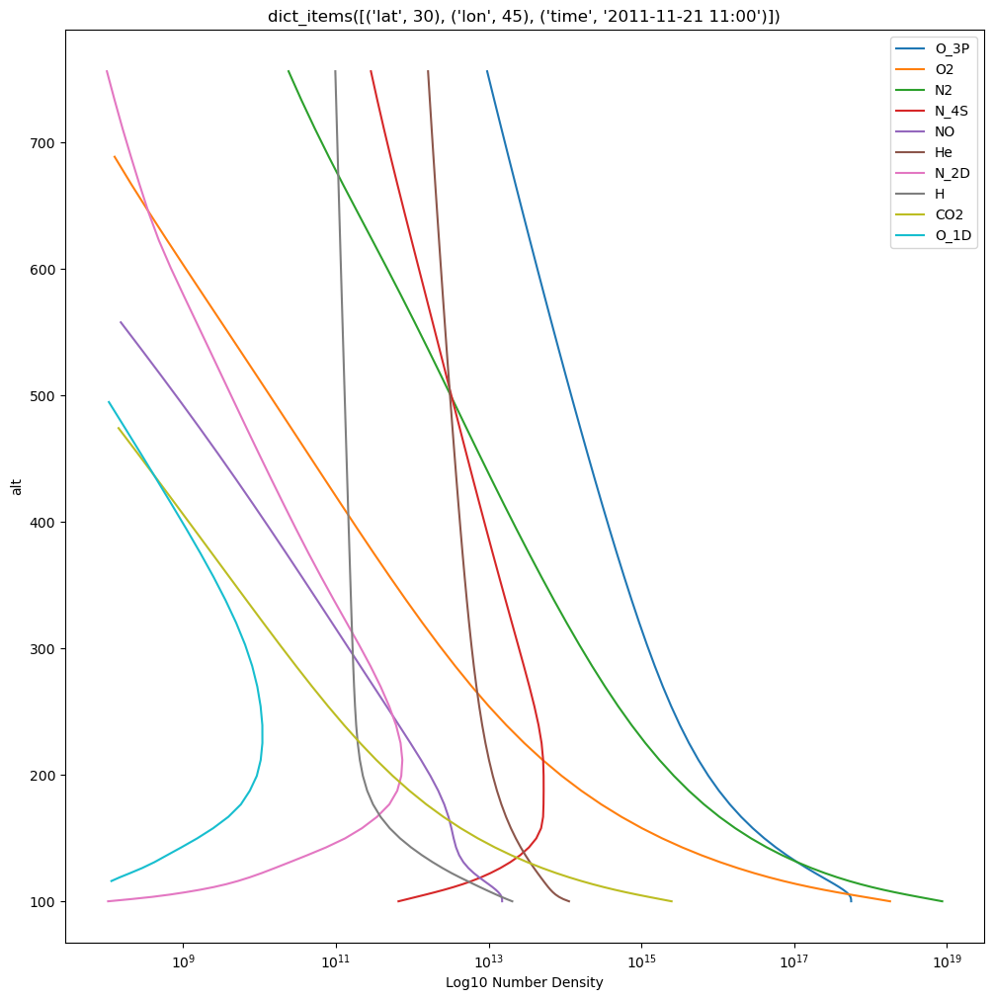

In [50]:

pt = {'lat':30, 'lon':45, 'time':'2011-11-21 11:00'}


plt.figure(figsize=(12,12))




for v in list(gitms['bz17'].data_vars)[13:-6]:
    if ('Temp' not in v and 'plus' not in v):
        if gitms['bz17'][v].sel(pt, method='nearest').max() > 10**10:
            gitms['bz17'][v].sel(pt, method='nearest').where(gitms['bz17'][v].sel(pt, method='nearest') > 10**8).plot(y='alt', label=v)
        

plt.title(pt.items())
plt.xscale('log')
plt.xlabel('Log10 Number Density')
plt.legend()
plt.show()
plt.close()

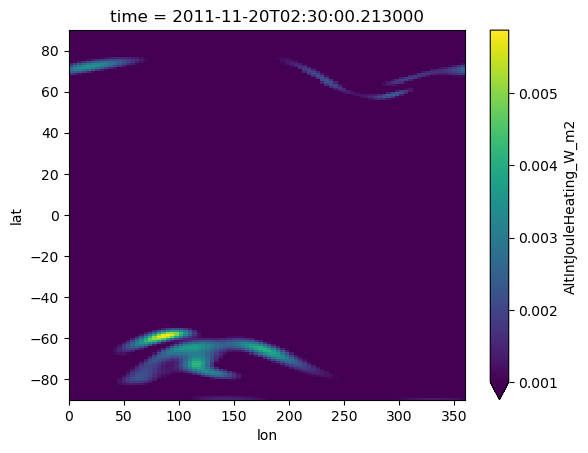

In [51]:
gitms['bz17'].AltIntJouleHeating_W_m2.isel(time=30).T.plot(vmin=.001, vmax=None)

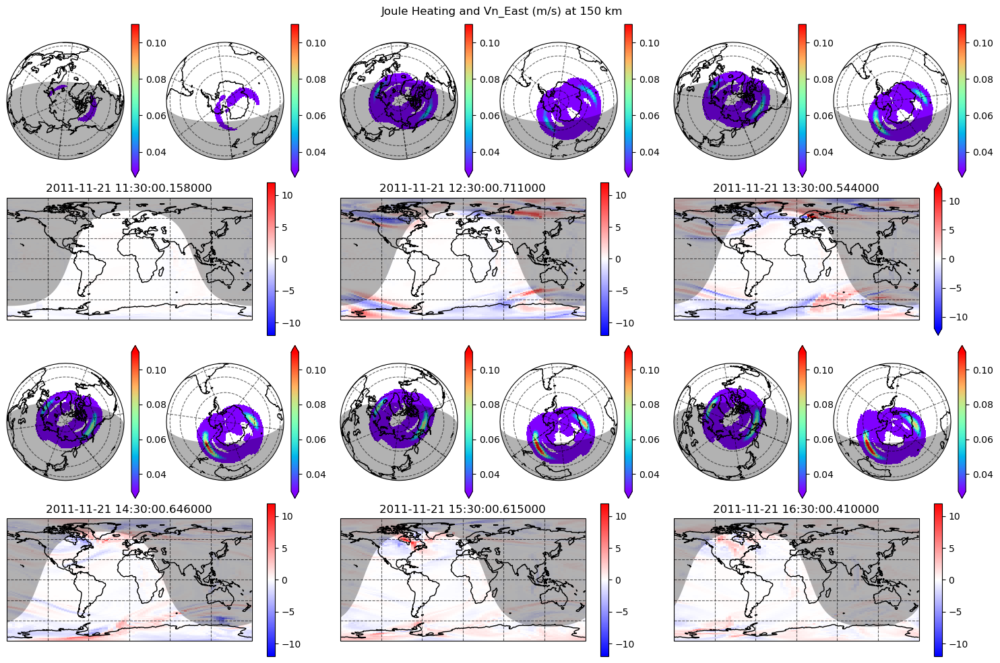

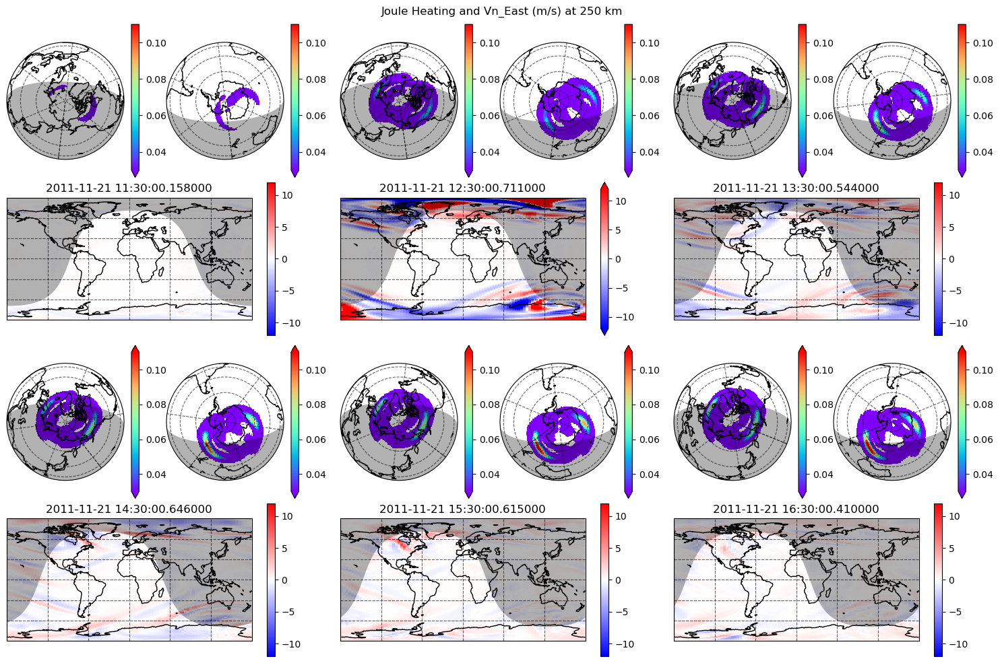

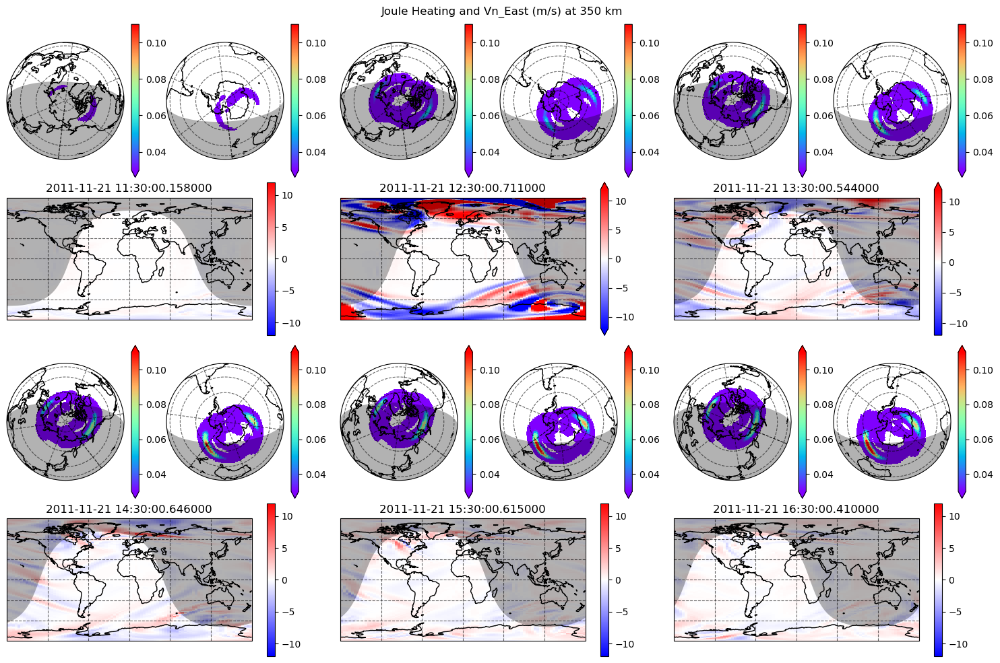

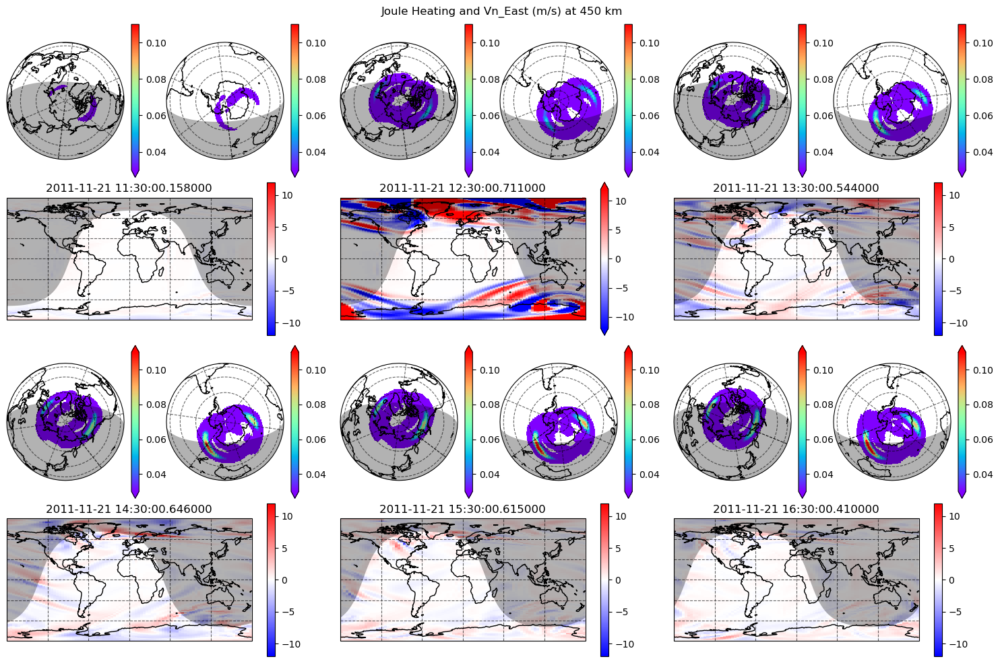

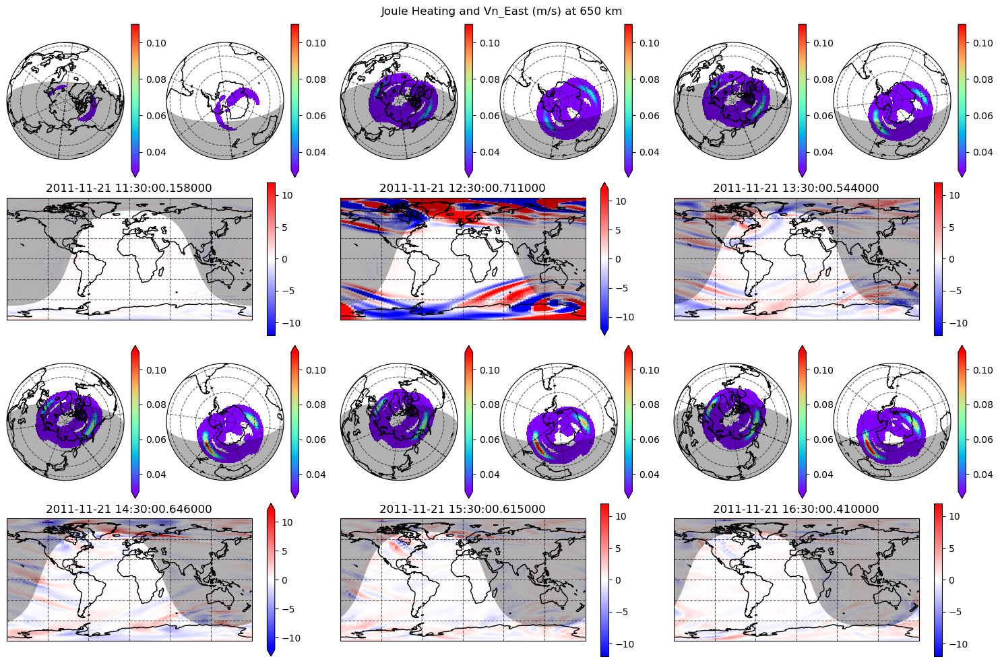

In [226]:
alts = [150, 250, 350, 450, 650]

for a in alts:

    _ = plotting_routines.map_and_dials(dial_da=gitms['bz17'].AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_da=filters.filter_xarray_DA_diff(
                                            gitms['bz17'].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating and Vn_East (m/s) at %i km' %a,
                                        time_start='2011-11-21 11:30',
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-12, vmax_map=12)
    plt.show()

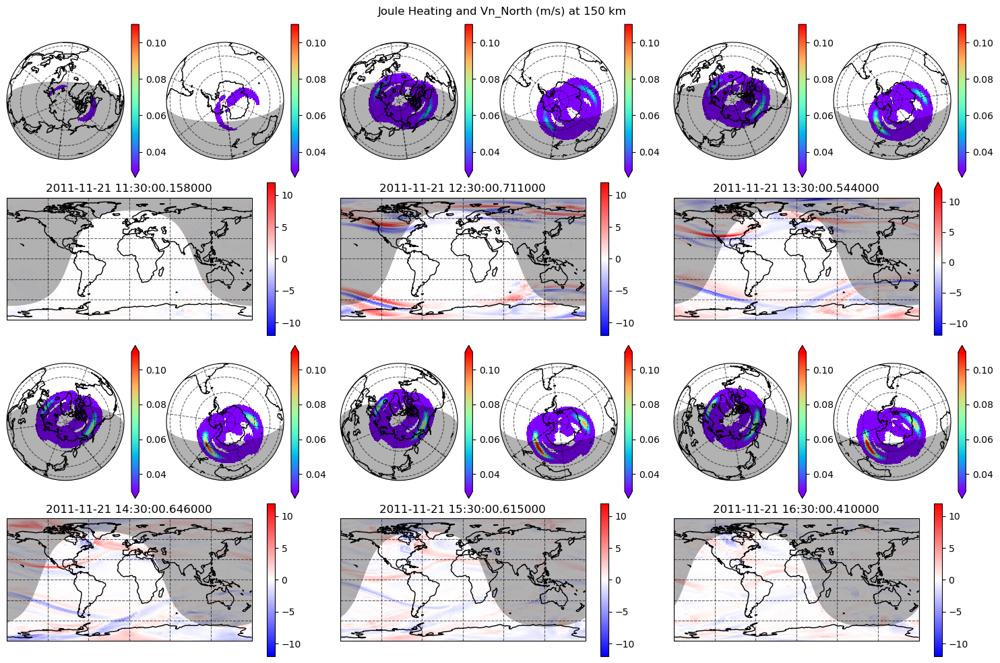

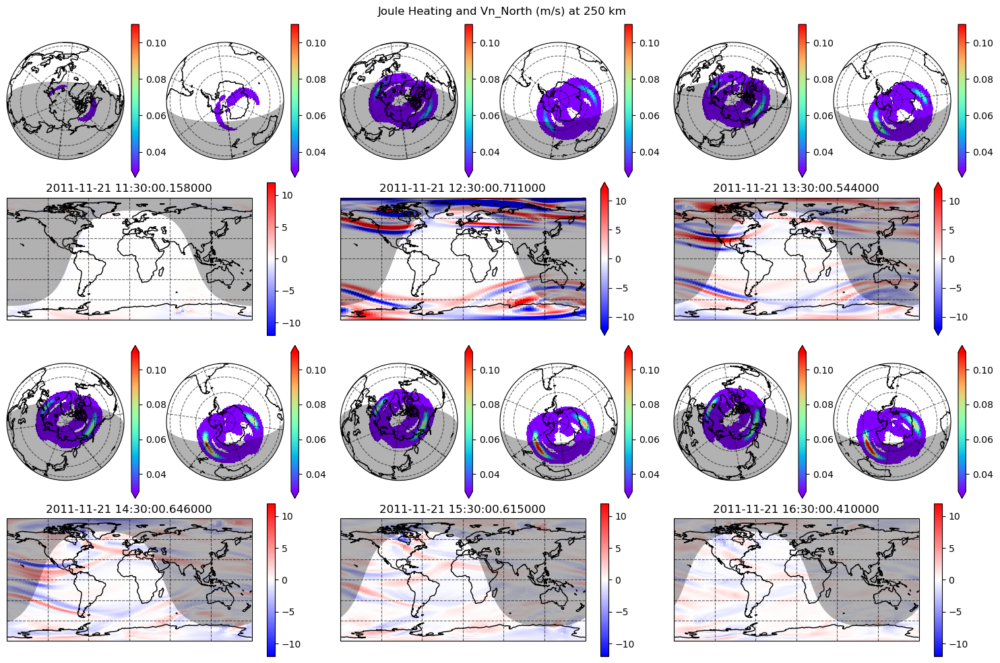

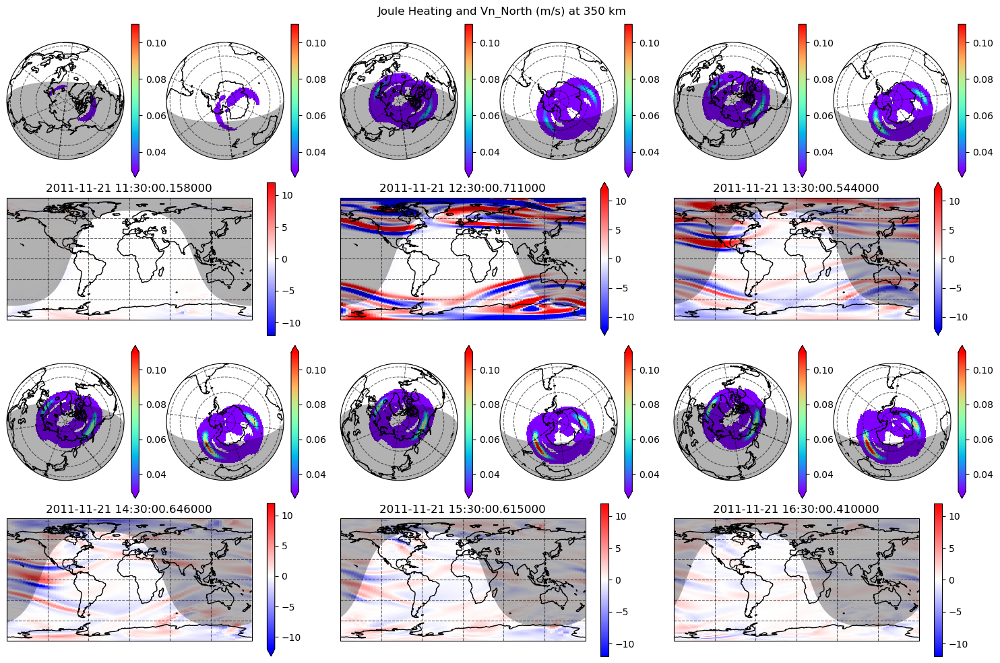

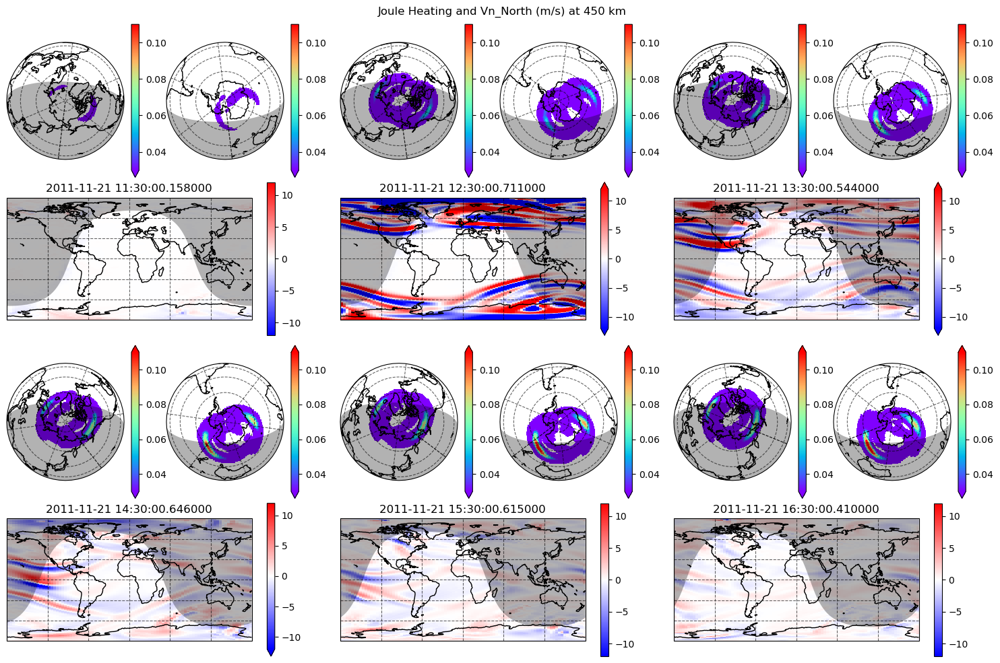

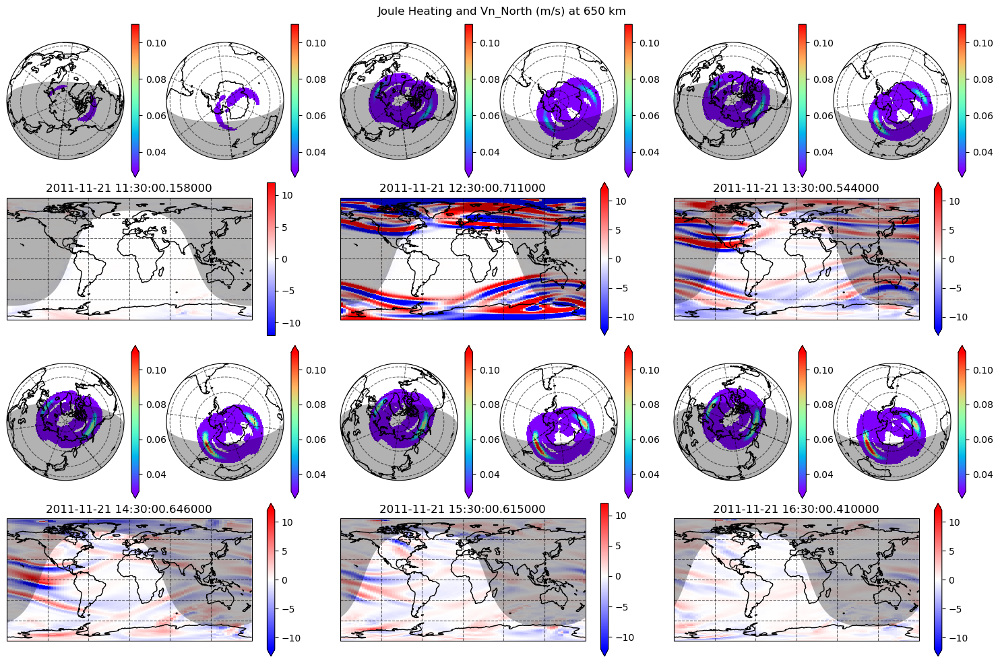

In [227]:
alts = [150, 250, 350, 450, 650]

for a in alts:

    _ = plotting_routines.map_and_dials(dial_da=gitms['bz17'].AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_da=filters.filter_xarray_DA_diff(
                                            gitms['bz17'].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating and Vn_North (m/s) at %i km' %a,
                                        time_start='2011-11-21 11:30',
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-12, vmax_map=12)
    plt.show()

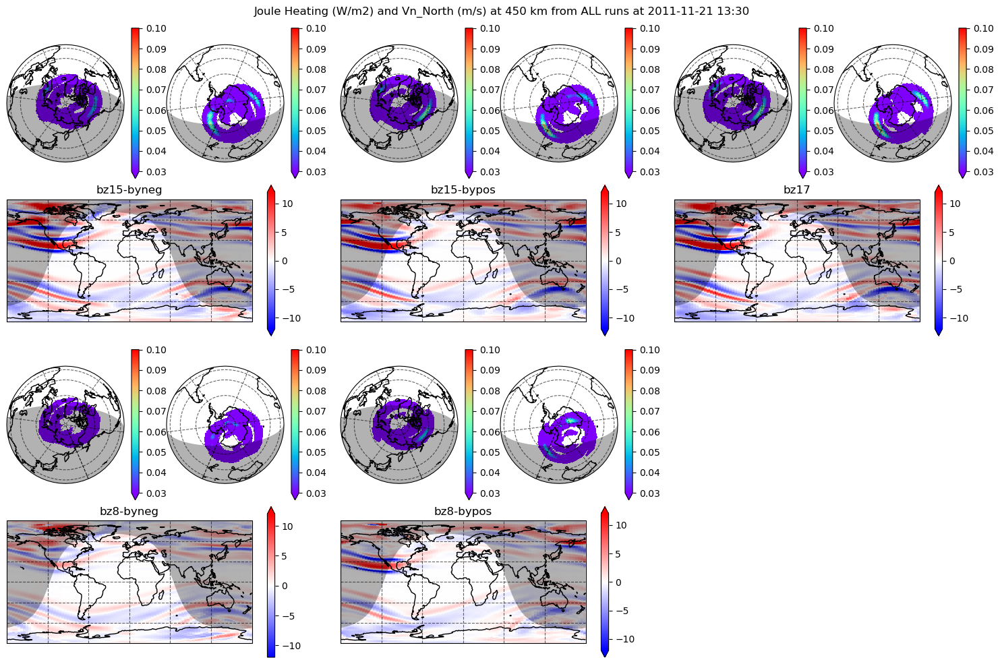

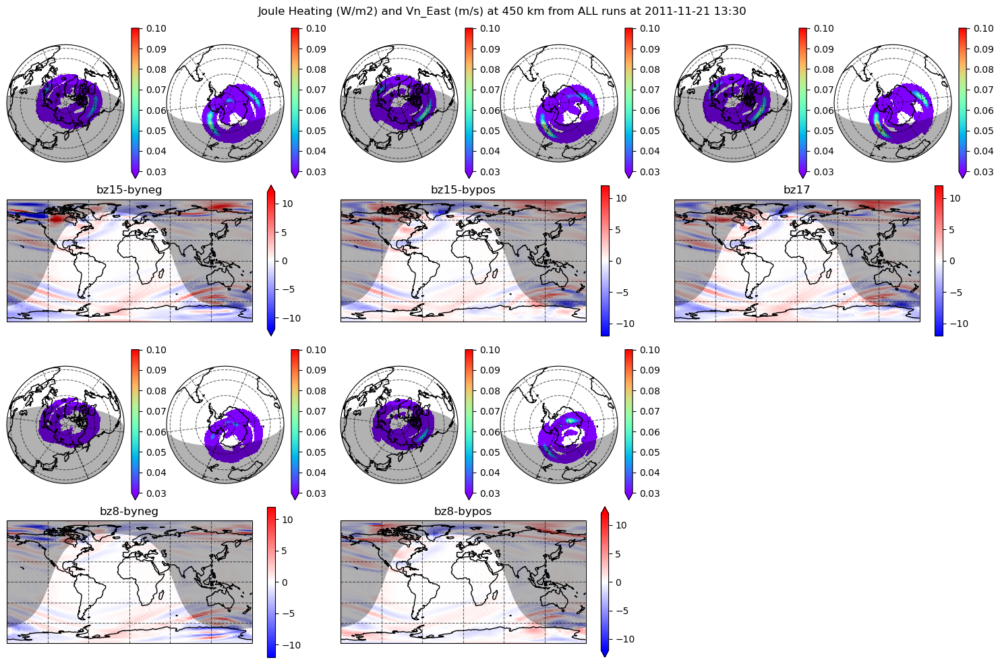

In [245]:
t = '2011-11-21 13:30'
a = 450

map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in gitms.keys():
    dial_data[k] = gitms[k].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
    map_data[k] = filters.filter_xarray_DA_diff(
        gitms[k].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')
    titles.append(k)
    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=5,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, several_datasets=True)
    
plt.show()
plt.close()





map_data = xr.Dataset()
dial_data = xr.Dataset()
titles = []

for k in gitms.keys():
    dial_data[k] = gitms[k].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
    map_data[k] = filters.filter_xarray_DA_diff(
        gitms[k].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')

    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=5,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_East (m/s) at %i km from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, several_datasets=True)
    
plt.show()
plt.close()


#####~~~~~~~~~~~~########



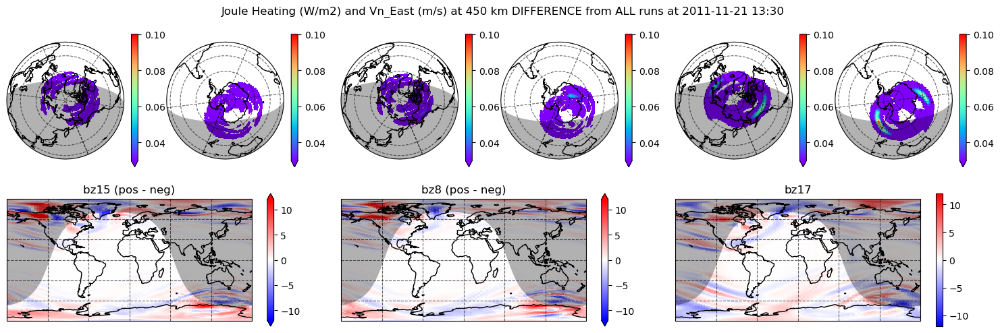

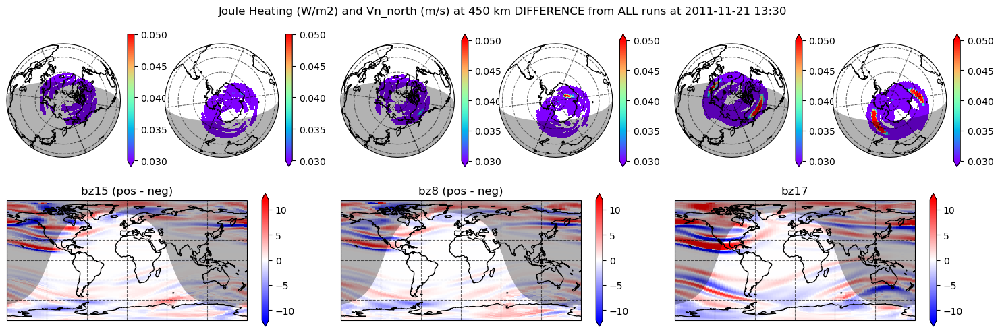

In [249]:
t = '2011-11-21 13:30'
a = 450

map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest') - gitms[k[1]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[2]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest') - \
        filters.filter_xarray_DA_diff(
            gitms[k[1]].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')
    except:
        dial_data[k[0]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=3,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_East (m/s) at %i km FIT DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, several_datasets=True)
    
plt.show()
plt.close()

###### ~~~~~~~ #########

map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest') - gitms[k[1]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[2]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest') - \
        filters.filter_xarray_DA_diff(
            gitms[k[1]].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')
    except:
        dial_data[k[0]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=3,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km FIT DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.003, vmax_dial=.05, vmin_map=-12, vmax_map=12, several_datasets=True)
    
plt.show()
plt.close()


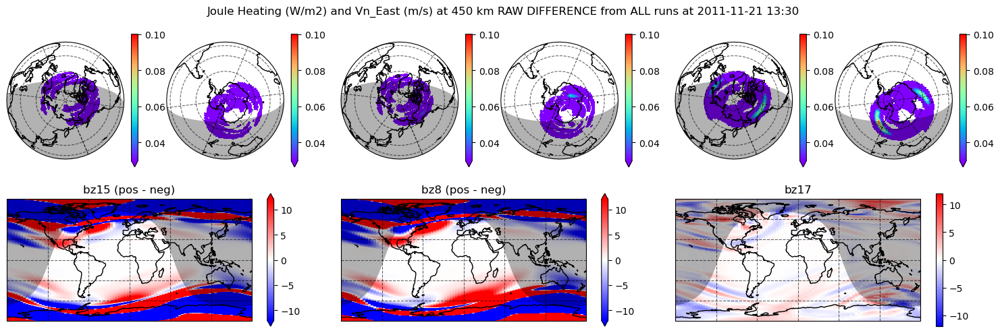

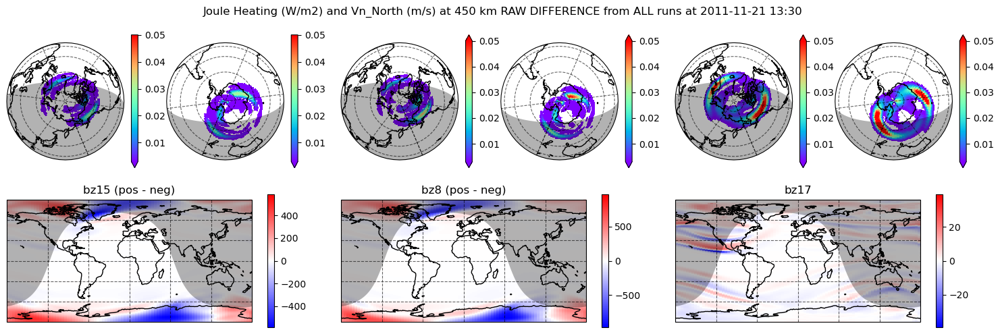

In [255]:
map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest') - gitms[k[1]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[2]] = gitms[k[0]].Vn_east.sel(alt=a, method='nearest').sel(time=t, method='nearest') - gitms[k[1]].Vn_east.sel(alt=a, method='nearest').sel(time=t, method='nearest')
    except:
        dial_data[k[0]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_east.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=3,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_East (m/s) at %i km RAW DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.10, vmin_map=-12, vmax_map=12, several_datasets=True)
    
plt.show()
plt.close()

###### ~~~~~~~ #########

map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest') - gitms[k[1]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[2]] = gitms[k[0]].Vn_north.sel(alt=a, method='nearest').sel(time=t, method='nearest') - gitms[k[1]].Vn_north.sel(alt=a, method='nearest').sel(time=t, method='nearest')
    except:
        dial_data[k[0]] = gitms[k[0]].AltIntJouleHeating_W_m2.sel(time=t, method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=3,
                                        map_da=map_data,
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km RAW DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=0.003, vmax_dial=.05, several_datasets=True)
    
plt.show()
plt.close()

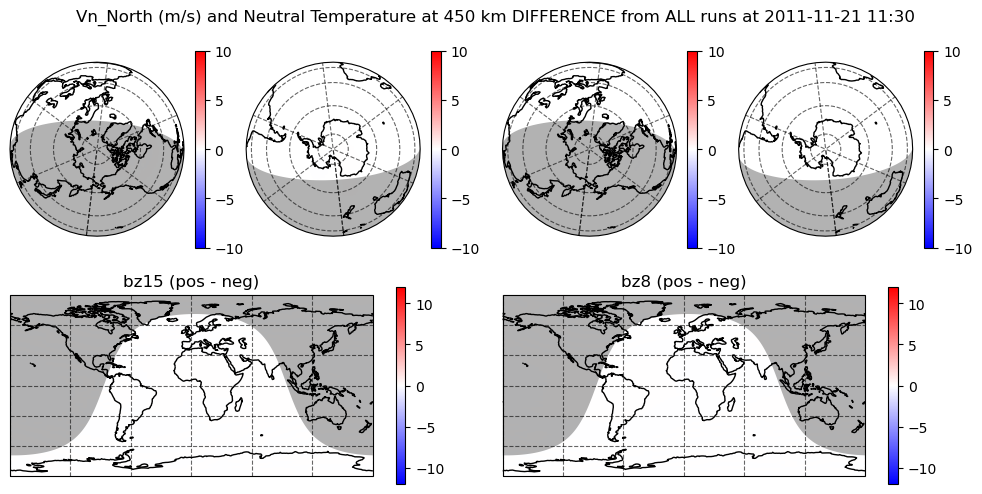

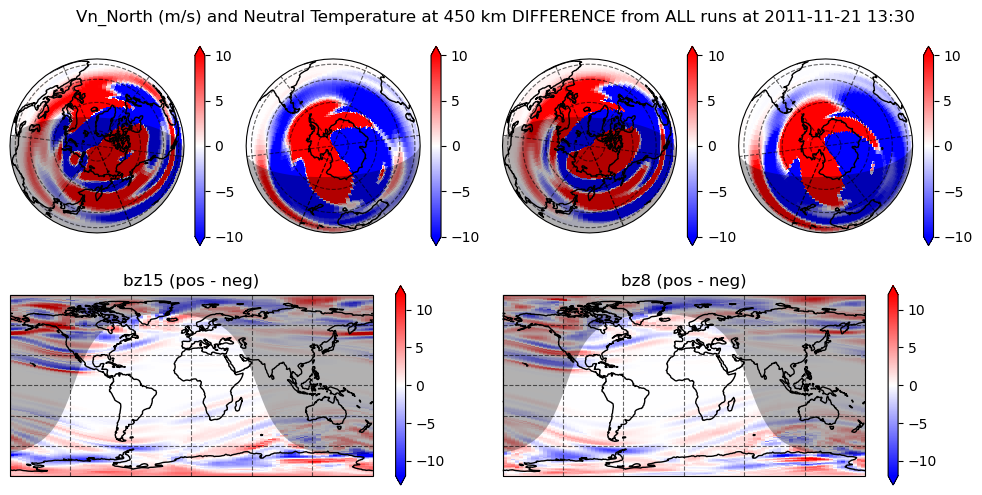

In [71]:
t = '2011-11-21 11:30'
a = 450

map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].Vn_north.sel(time=t, alt=a, method='nearest') - gitms[k[1]].Vn_north.sel(time=t, alt=a, method='nearest')
        map_data[k[2]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest') - \
        filters.filter_xarray_DA_diff(
            gitms[k[1]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')
    except:
        # pass
        dial_data[k[0]] = gitms[k[0]].Vn_north.sel(time=t, alt=a,  method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=2,
                                        map_da=map_data,
                                        max_per_row=2, 
                                        suptitle='Vn_North (m/s) and Neutral Temperature at %i km DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=-10, vmax_dial=10, vmin_map=-12, vmax_map=12, several_datasets=True, dial_cmap='bwr')
    
plt.show()
plt.close()

t = '2011-11-21 13:30'
a = 450

map_data = xr.Dataset()
dial_data = xr.Dataset()


subt = [['bz15-bypos', 'bz15-byneg', 'bz15 (pos - neg)'], ['bz8-bypos', 'bz8-byneg', 'bz8 (pos - neg)'], ['bz17']]

for k in subt:
    try:
        dial_data[k[2]] = gitms[k[0]].Vn_north.sel(time=t, alt=a, method='nearest') - gitms[k[1]].Vn_north.sel(time=t, alt=a, method='nearest')
        map_data[k[2]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest') - \
        filters.filter_xarray_DA_diff(
            gitms[k[1]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')
    except:
        # pass
        dial_data[k[0]] = gitms[k[0]].Vn_north.sel(time=t, alt=a,  method='nearest')
        map_data[k[0]] = filters.filter_xarray_DA_diff(
            gitms[k[0]].Temperature.sel(alt=a, method='nearest'), percent=False, label='lower', order=2).sel(time=t, method='nearest')


    

fig = plotting_routines.map_and_dials(dial_da=dial_data,
                                        total=2,
                                        map_da=map_data,
                                        max_per_row=2, 
                                        suptitle='Vn_North (m/s) and Neutral Temperature at %i km DIFFERENCE from ALL runs at %s' %(a, t),
                                        map_cmap='bwr', vmin_dial=-10, vmax_dial=10, vmin_map=-12, vmax_map=12, several_datasets=True, dial_cmap='bwr')
    
plt.show()
plt.close()


In [235]:
list(map_data.data_vars)

['bz15-byneg', 'bz15-bypos', 'bz17', 'bz8-byneg', 'bz8-bypos']

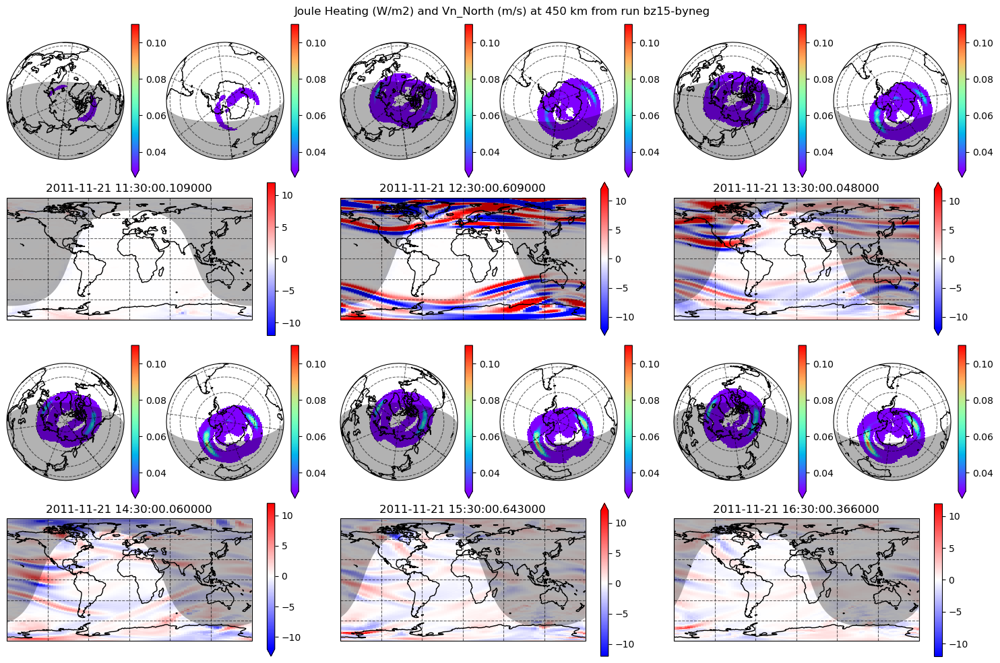

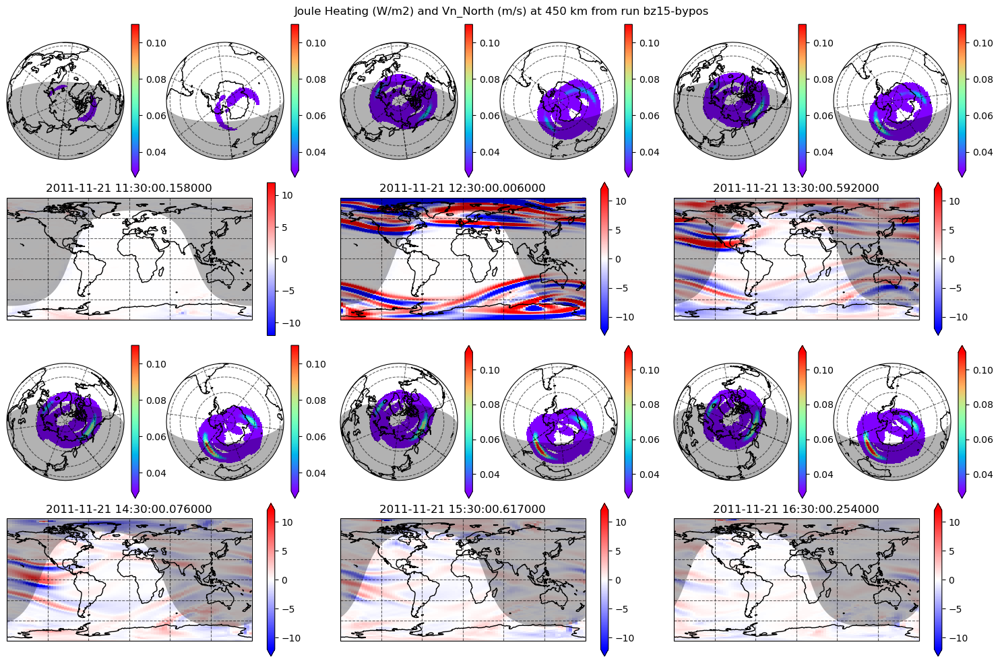

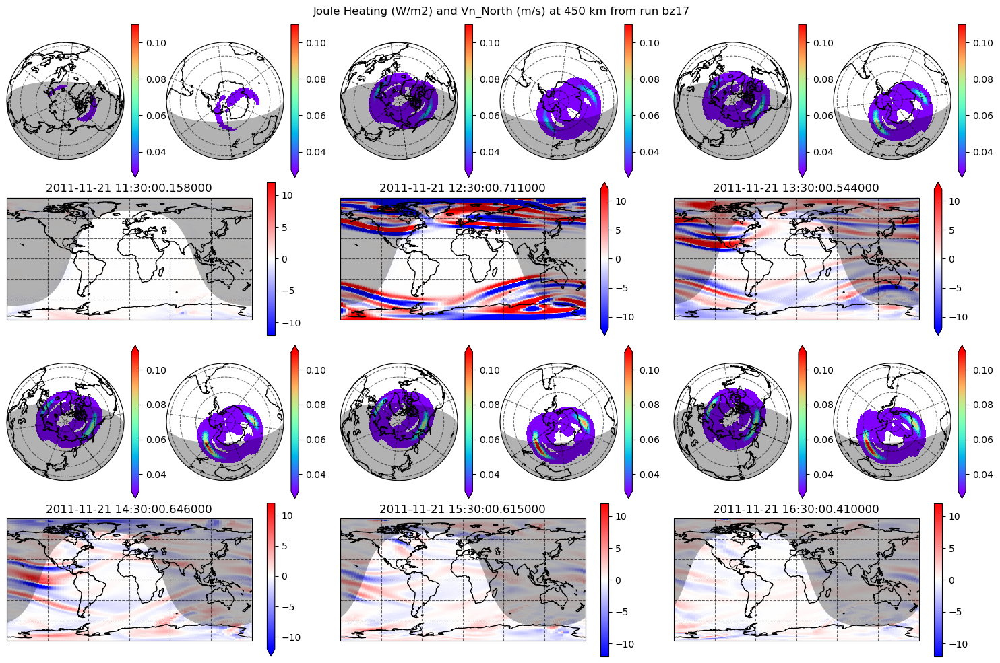

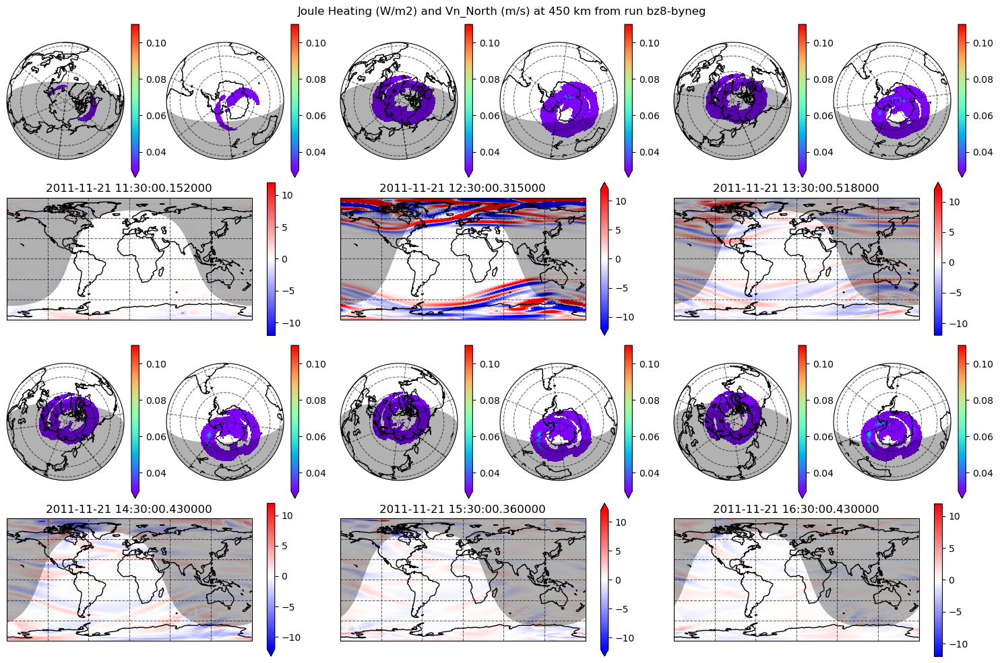

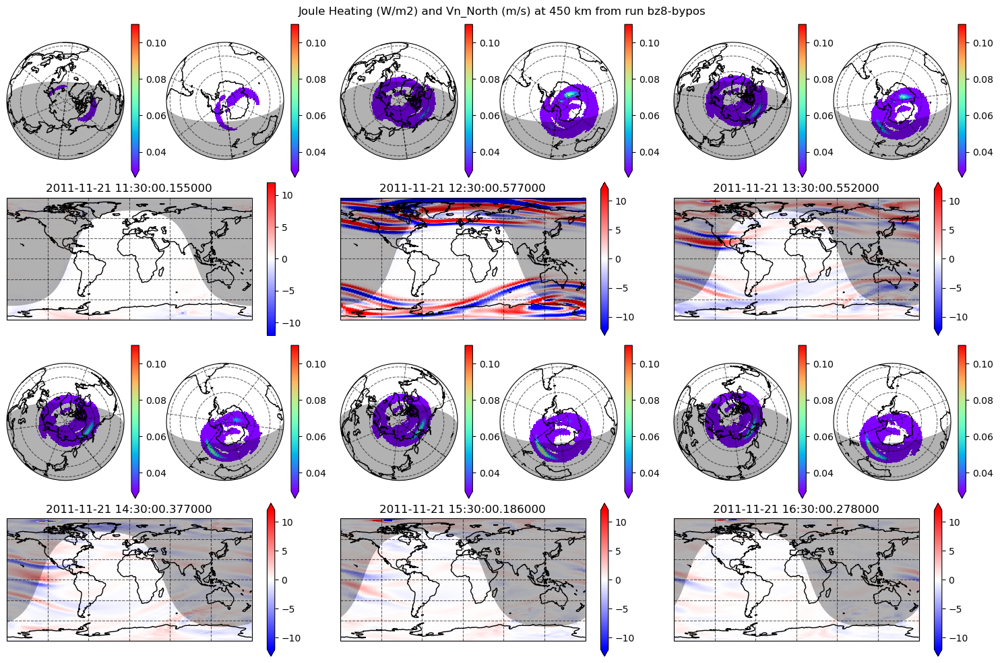

In [233]:
## Plot all runs out.
t = '2011-11-21 11:30'
a = 450
for k in gitms.keys():
    _ = plotting_routines.map_and_dials(dial_da=gitms[k].AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_da=filters.filter_xarray_DA_diff(
                                            gitms[k].Vn_north.sel(alt=a, method='nearest'), percent=False, label='lower', order=2),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km from run %s' %(a, k),
                                        time_start=t,
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-12, vmax_map=12)
    plt.show()

In [ ]:
## Plot all runs out.
t = '2011-11-21 11:30'
a = 450
for k in gitms.keys():
    plotting_routines.map_and_dials(dial_da=gitms[k].AltIntJouleHeating_W_m2,
                  total=6,
                  map_da=filters.filter_xarray_DA_diff(gitms[k].sel(alt=a, method='nearest'),
                                                       percent=False, label='lower', order=2),
                  max_per_row=3, mask_dials=0.002,
                  suptitle='Joule Heating (W/m2) and Horizontal Velocity Amplitude at %i km from run %s' % (a, k),
                  time_start=t,
                  quiver_map_cols=['Vn_east', 'Vn_north', 'amp'],
                  map_cmap='Reds', vmin_dial=0.03, vmax_dial=.11, vmin_map=-15, vmax_map=15)
plt.show()

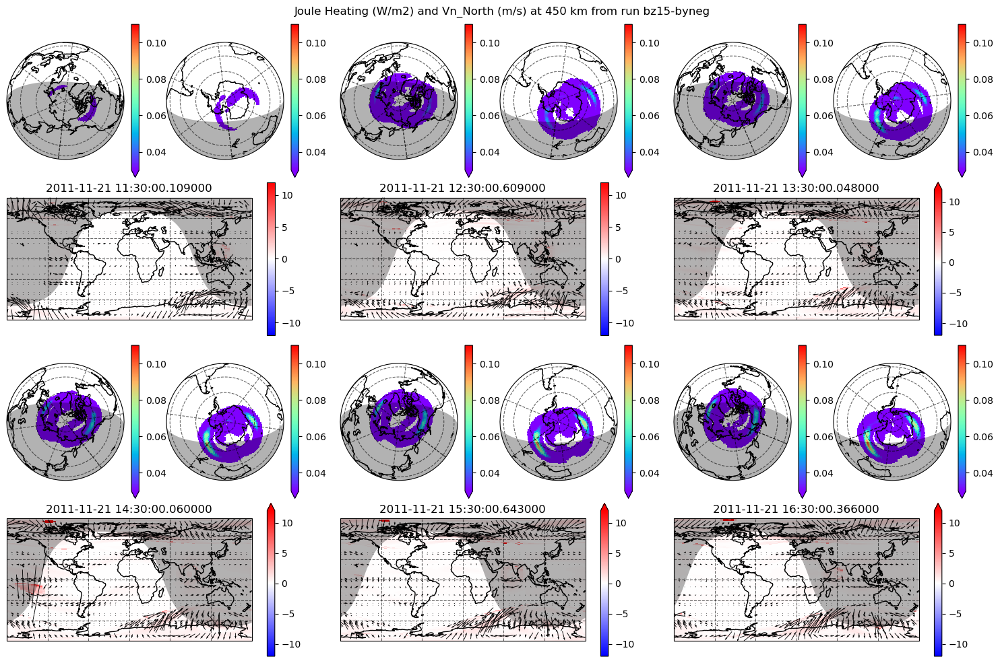

In [10]:
## Plot all runs out.
t = '2011-11-21 11:30'
a = 450
for k in gitms.keys():
    _ = plotting_routines.map_and_dials_quiver(dial_da=gitms[k].AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_ds=filters.filter_xarray_DA_diff(
                                            gitms[k].sel(alt=a, method='nearest'), percent=False, label='lower', order=2),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Vn_North (m/s) at %i km from run %s' %(a, k),
                                        time_start=t, x_colname='Vi_east', y_colname='Vi_north',
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-12, vmax_map=12)
    plt.show()
    break

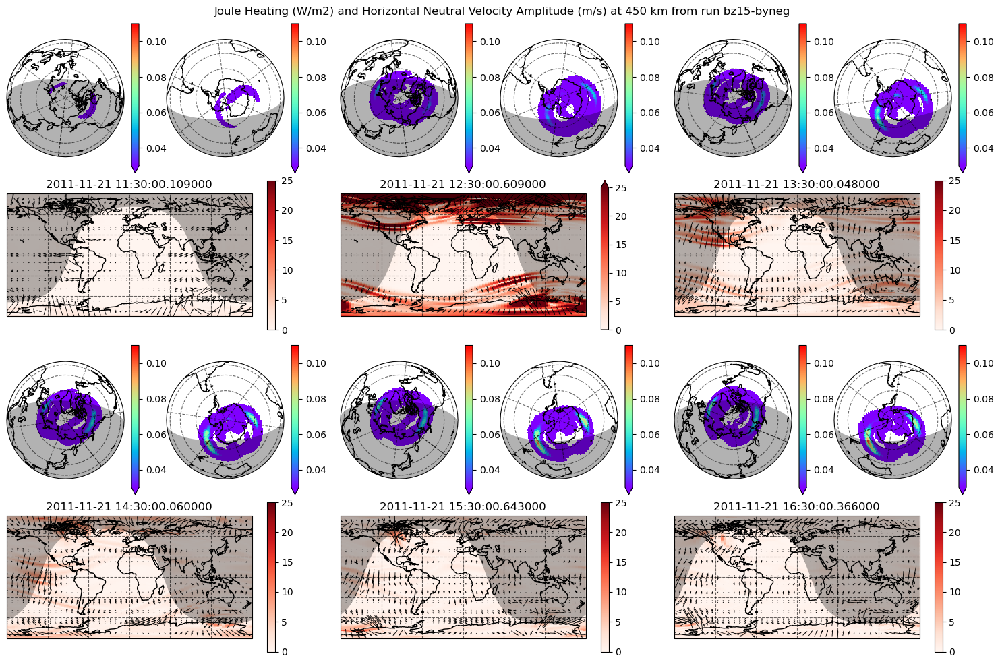

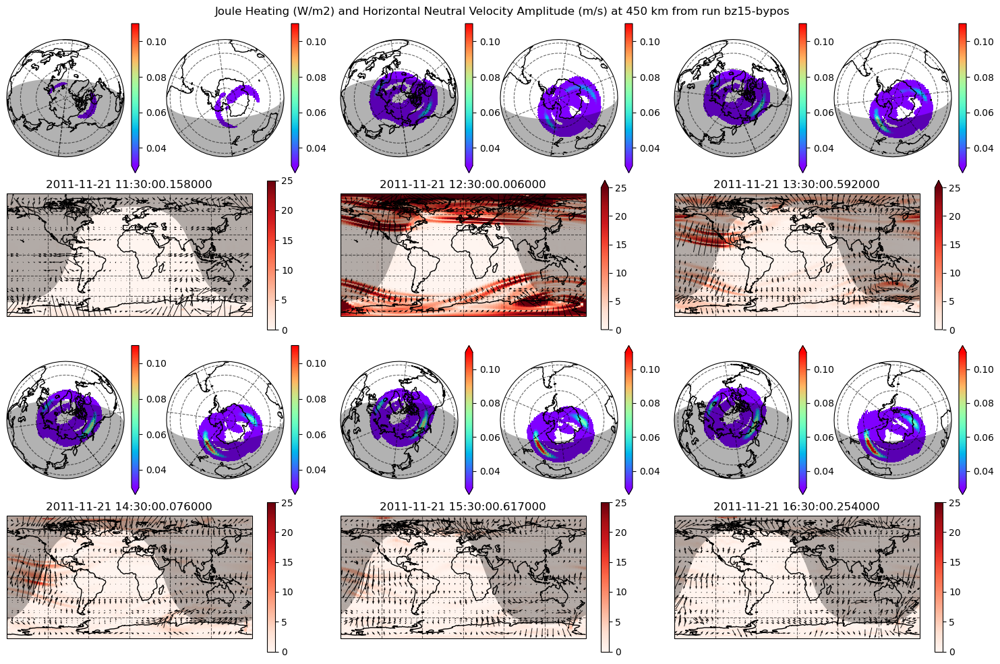

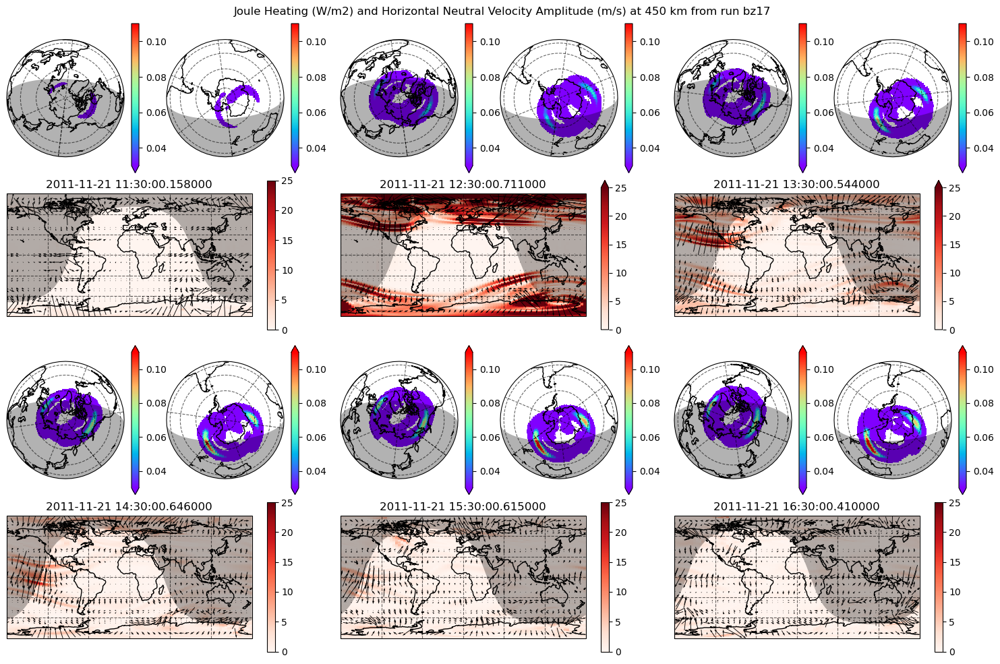

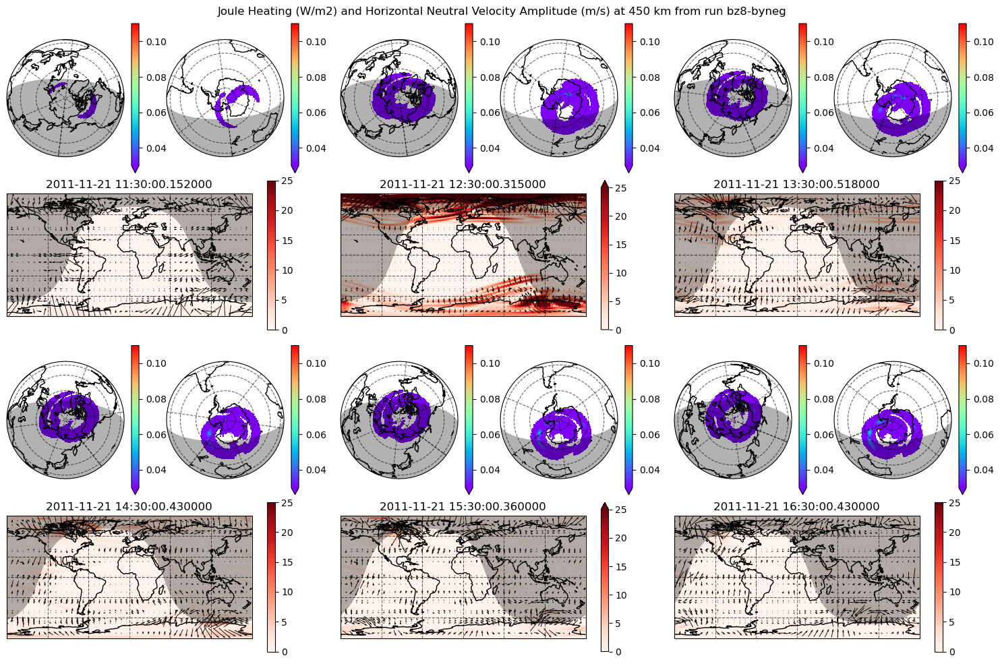

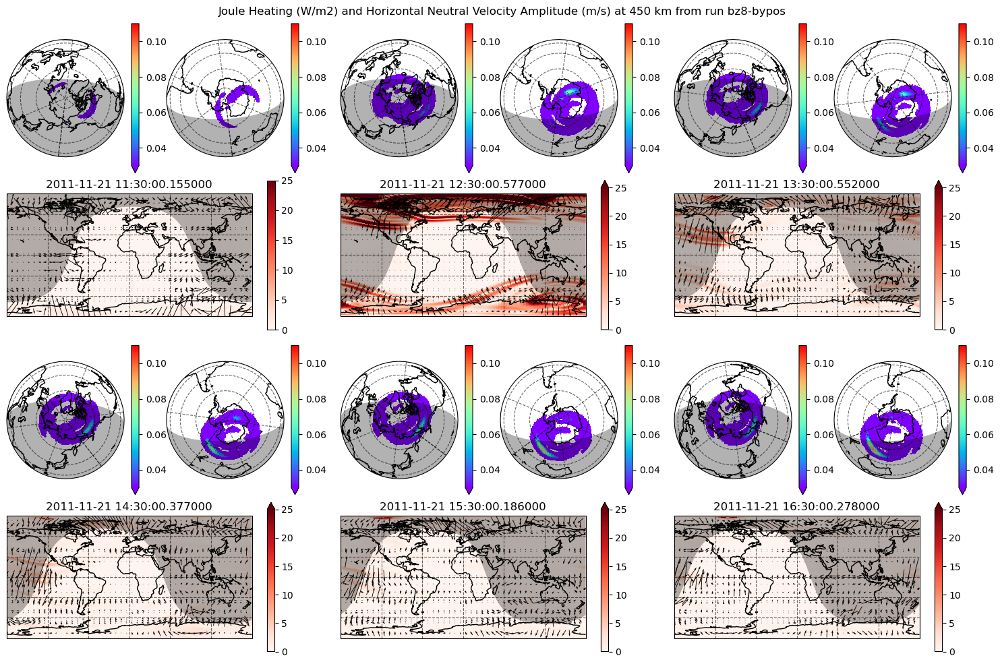

In [16]:
## Plot all runs out.
t = '2011-11-21 11:30'
a = 450
for k in gitms.keys():
    _ =plotting_routines.map_and_dials_quiver(dial_da=gitms[k].AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_ds=filters.filter_xarray_DA_diff(
                                            gitms[k].sel(alt=a, method='nearest'), percent=False, label='lower', order=2),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Joule Heating (W/m2) and Horizontal Neutral Velocity Amplitude (m/s) at %i km from run %s' %(a, k),
                                        time_start=t, x_colname='Vn_east', y_colname='Vn_north',
                                        map_cmap='Reds', vmin_dial=0.03, vmax_dial=.11, vmin_map=0, vmax_map=25)
    plt.show()
    # break

In [60]:
def subt_ds_for_quiver(ds1,
                       ds2,
                       dial_col='AltIntJouleHeating_W_m2',
                       quiver_x='Vn_east',
                       quiver_y='Vn_north',
                       color_col='v_mag_diff'
                      ):
    
    combo = xr.Dataset()
    combo['dial'] = ds1[dial_col] - ds2[dial_col]
    
    combo['qx'] = ds1[quiver_x] - ds2[quiver_x]
    combo['qy'] = ds1[quiver_y] - ds2[quiver_y]
    
    if color_col=='v_mag_diff':
        combo['color'] = (np.sqrt(ds1[quiver_x]**2 + ds1[quiver_y]**2)
                      - np.sqrt(ds2[quiver_x]**2 + ds2[quiver_y]**2))
    
    return combo

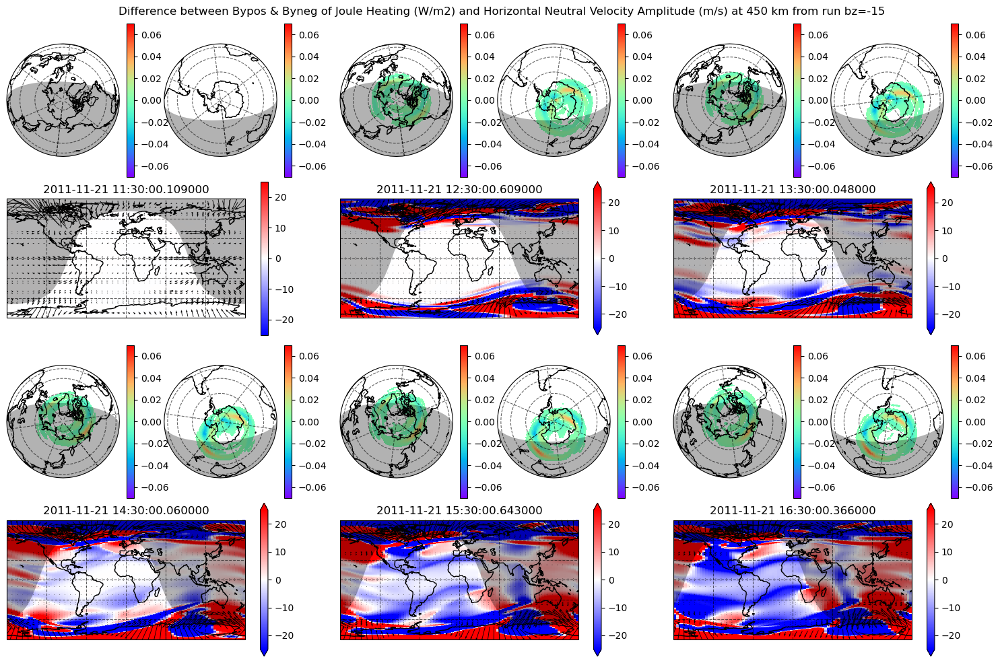

In [68]:
t = '2011-11-21 11:30'
a = 450

bz15 = subt_ds_for_quiver(gitms['bz15-bypos'].sel(alt=a, method='nearest'), gitms['bz15-byneg'].sel(alt=a, method='nearest'))

_ =plotting_routines.map_and_dials_quiver(dial_da=bz15.dial,
                                        total=6,
                                        map_ds=bz15,
                                        max_per_row=3, 
                                        suptitle='Difference between Bypos & Byneg of Joule Heating (W/m2) and Horizontal Neutral Velocity Amplitude (m/s) at %i km from run bz=-15' %(a),
                                        time_start=t, x_colname='qx', y_colname='qy', color_col='color',
                                        map_cmap='bwr', vmin_dial=-.07, vmax_dial=.07,
                                        vmin_map=-25, vmax_map=25)

In [9]:
## Plot all runs out.
t = '2011-11-21 11:30'
a = 450

bz15 = gitms['bz15-bypos'] - gitms['bz15-byneg']

bz15['v_mag_diff'] = (np.sqrt(gitms['bz15-bypos'].Vn_east**2 + gitms['bz15-bypos'].Vi_north**2)
                      - np.sqrt(gitms['bz15-byneg'].Vn_east**2 + gitms['bz15-byneg'].Vi_north**2))

bz8 = gitms['bz8-bypos'] - gitms['bz8-byneg'].reindex_like(gitms['bz8-bypos'], method='nearest')
bz8['v_mag_diff'] = ((gitms['bz8-bypos'].Vn_east**2 + gitms['bz8-bypos'].Vi_north**2)**1/2
                      - ((gitms['bz8-byneg'].Vn_east**2 + gitms['bz8-byneg'].Vi_north**2)**1/2))#.reindex_like(gitms['bz8-bypos'], method='nearest'))

_ =plotting_routines.map_and_dials_quiver(dial_da=bz15.AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_ds=bz15.sel(alt=a, method='nearest'),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Difference between Bypos & Byneg of Joule Heating (W/m2) and Horizontal Neutral Velocity Amplitude (m/s) at %i km from run bz=-15' %(a),
                                        time_start=t, x_colname='Vn_east', y_colname='Vn_north', color_col='v_mag_diff',
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-25, vmax_map=25)
plt.show()


_ =plotting_routines.map_and_dials_quiver(dial_da=bz8.AltIntJouleHeating_W_m2,
                                        total=6,
                                        map_ds=bz8.sel(alt=a, method='nearest'),
                                        max_per_row=3, mask_dials=0.002,
                                        suptitle='Difference between Bypos & Byneg of Joule Heating (W/m2) and Horizontal Neutral Velocity Amplitude (m/s) at %i km from run bz=-8' %(a),
                                        time_start=t, x_colname='Vn_east', y_colname='Vn_north', color_col='v_mag_diff',
                                        map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-25, vmax_map=25)
plt.show()
    # break

TypeError: cannot directly convert an xarray.Dataset into a numpy array. Instead, create an xarray.DataArray first, either with indexing on the Dataset or by invoking the `to_array()` method.

In [136]:
times = []
for i in range(8):
    times.append(pd.Timestamp('2011-11-21 02:00') + pd.Timedelta('3 hours')*i)

In [137]:
times

[Timestamp('2011-11-21 02:00:00'),
 Timestamp('2011-11-21 05:00:00'),
 Timestamp('2011-11-21 08:00:00'),
 Timestamp('2011-11-21 11:00:00'),
 Timestamp('2011-11-21 14:00:00'),
 Timestamp('2011-11-21 17:00:00'),
 Timestamp('2011-11-21 20:00:00'),
 Timestamp('2011-11-21 23:00:00')]

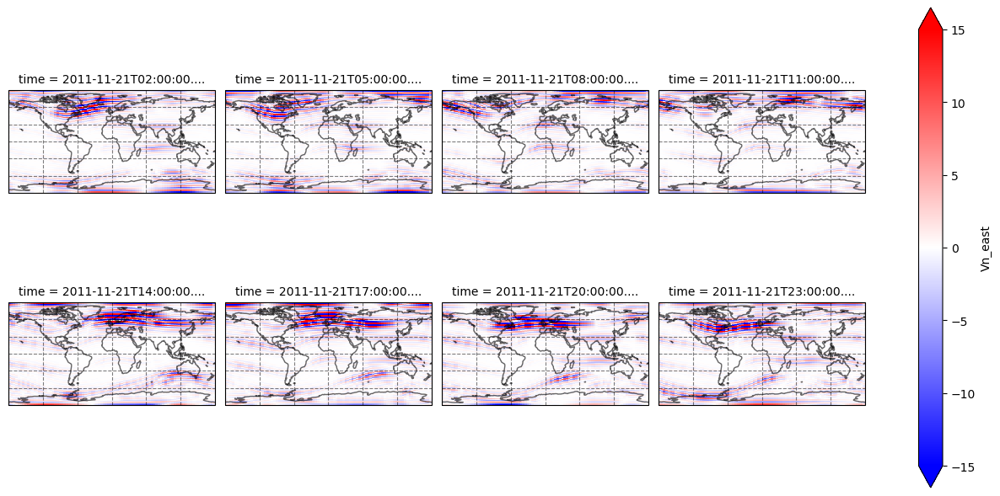

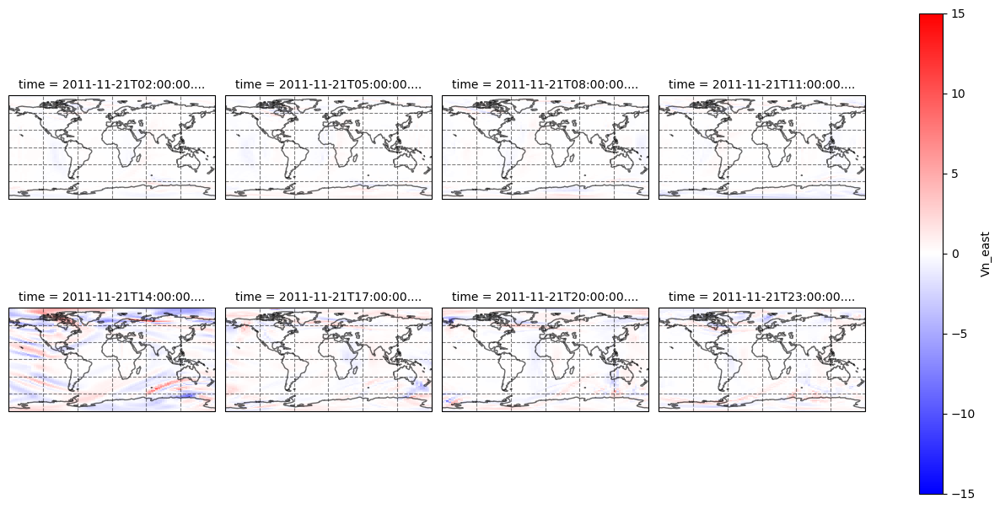

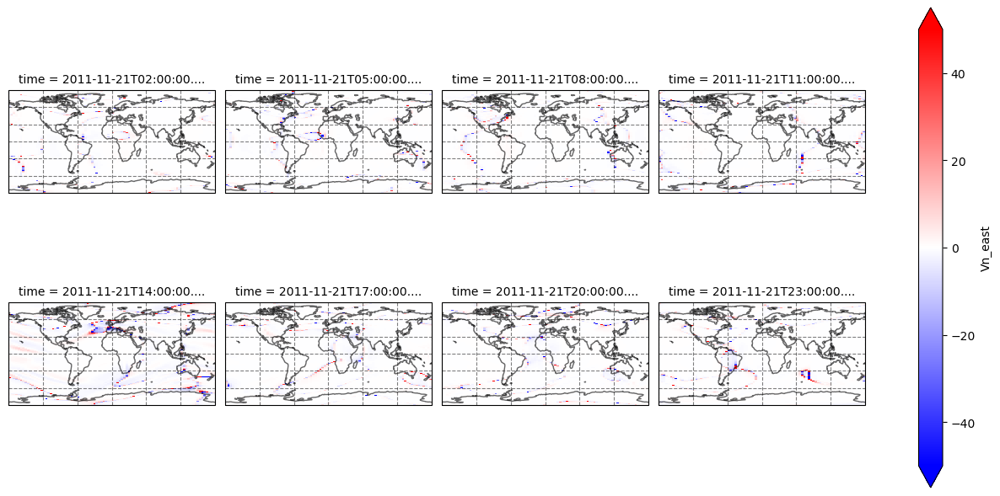

In [190]:


# plotting_routines.panel_plot((filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=120, highcut=50)
#                                                 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')),
#                              x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)
plotting_routines.panel_plot((filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=90, highcut=50, order=3)
                                                - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')),
                             x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)
# plotting_routines.panel_plot((filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=80, highcut=50)
#                                                 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')),
#                              x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)
# plotting_routines.panel_plot((filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=200, highcut=60)
#                                                 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')),
#                              x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)
# plotting_routines.panel_plot((filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=75, highcut=50)
#                                                 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')),
#                              x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)


plotting_routines.panel_plot(gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2),
                         x='lon', wrap_col='time',do_map=True,vlims=15,plot_vals=times)
plt.show()

plotting_routines.panel_plot((100*(gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Vn_east.sel(alt=450, method='nearest'))),
                         x='lon', wrap_col='time',do_map=True,vlims=50,plot_vals=times)


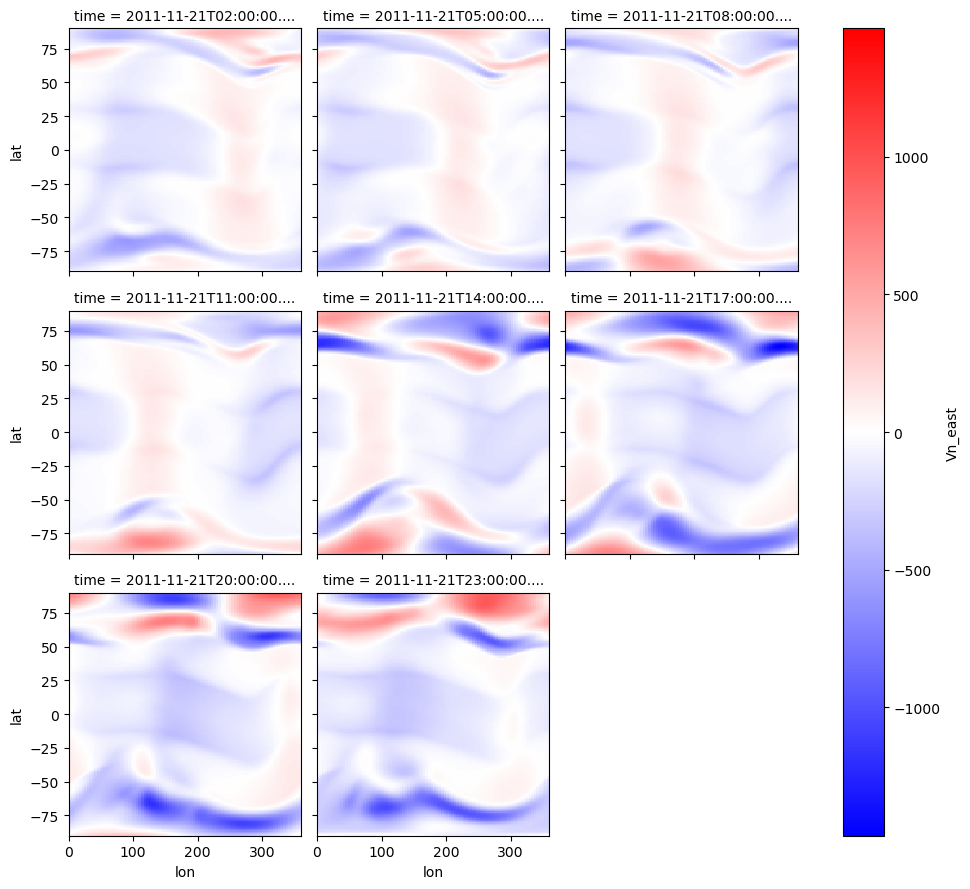

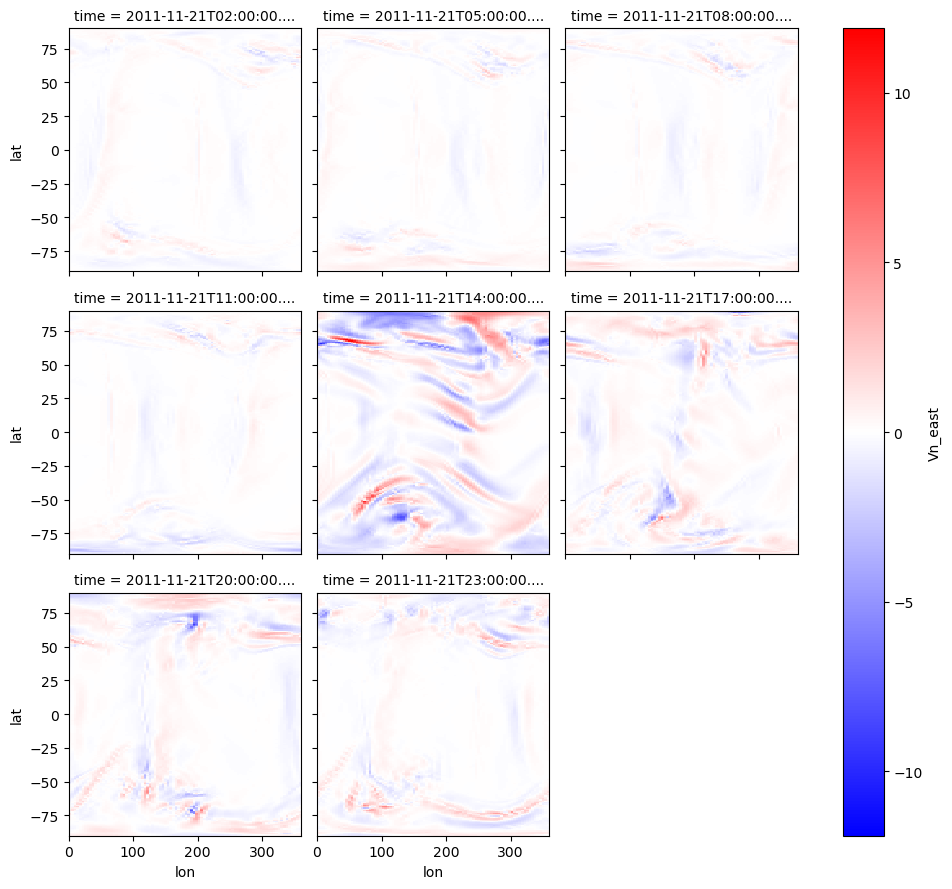

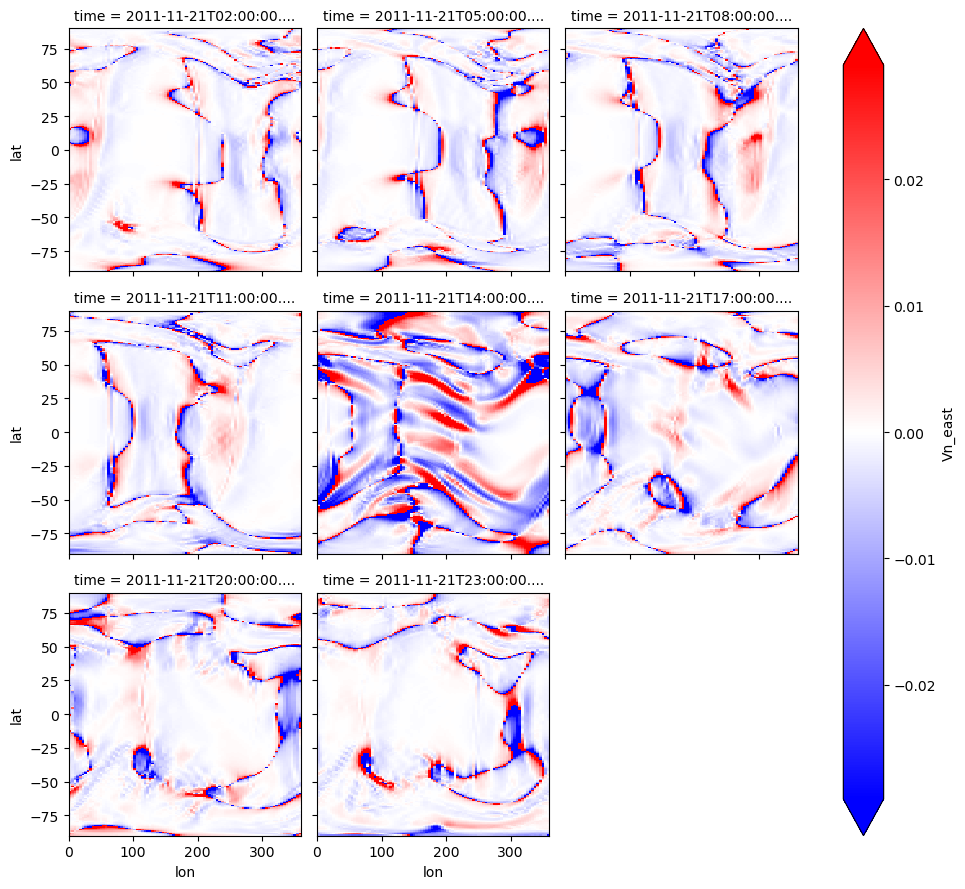

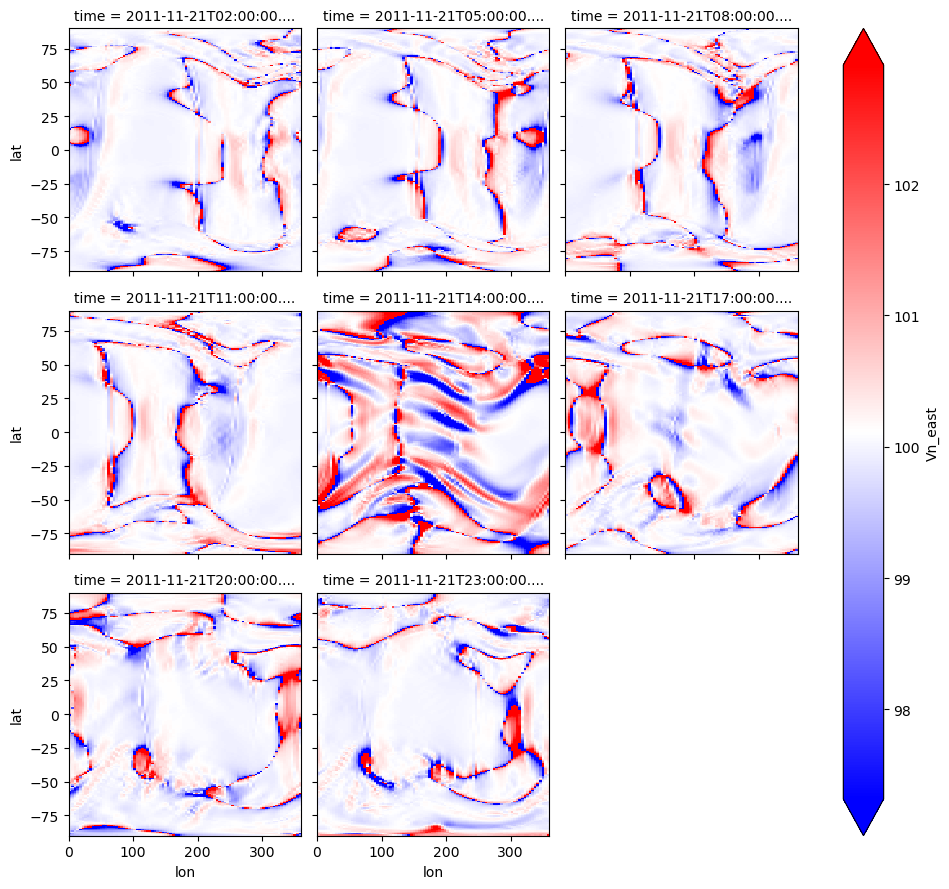

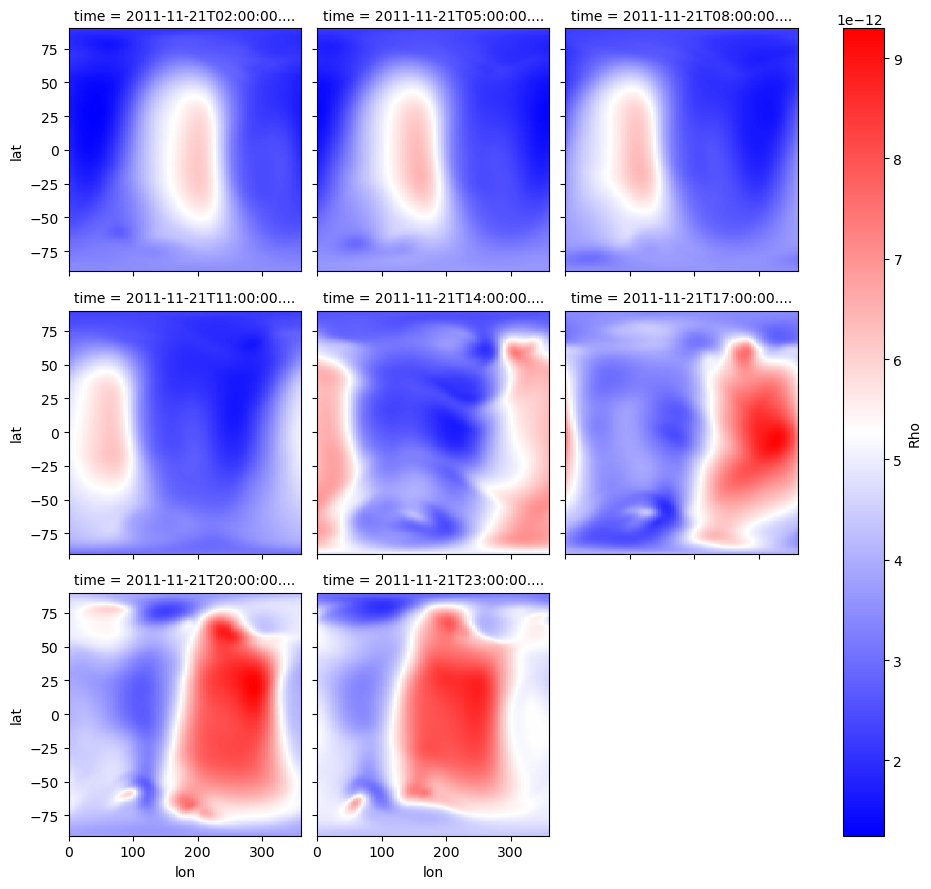

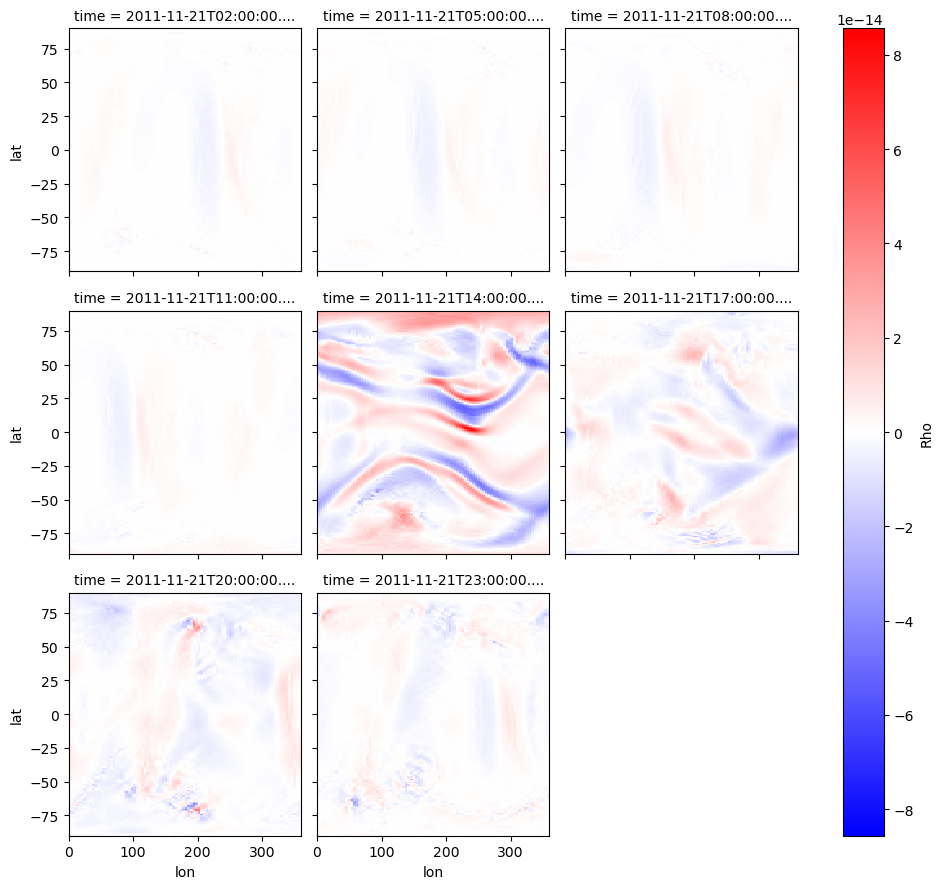

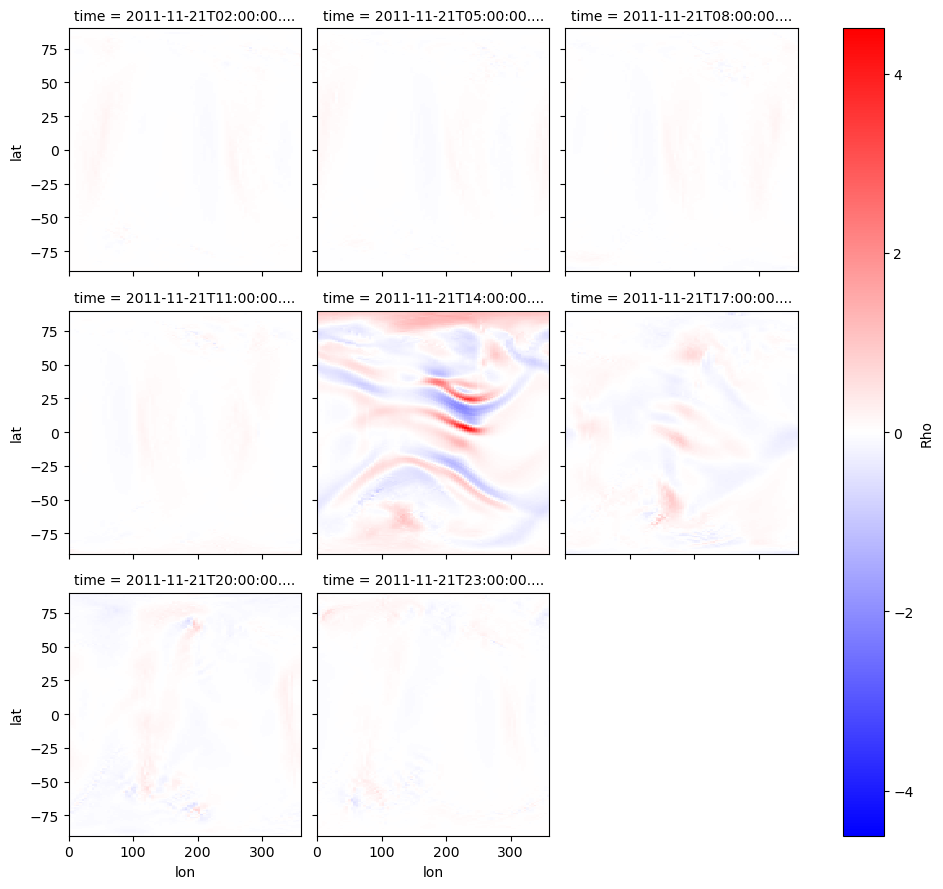

In [211]:
# plotting_routines.panel_plot((100*(gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Vn_east.sel(alt=450, method='nearest'))),
#                          x='lon', wrap_col='time',do_map=True,vlims=50,plot_vals=times)

# (100*(gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Vn_east.sel(alt=450, method='nearest'))).sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr', vmin=-15, vmax=15)
# plt.show()

a = gitms['bz17'].Vn_east.sel(alt=450, method='nearest')
a.sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
plt.show()
a.diff('time',2, label='lower').sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
plt.show()
(a.diff('time',2, label='lower')/a).sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr', robust=True)
plt.show()
(100*(a-a.diff('time',2, label='lower'))/a).sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr', robust=True)
plt.show()

print('\n\n\n')

a = gitms['bz17'].Rho.sel(alt=450, method='nearest')
a.sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
plt.show()
a.diff('time',2, label='lower').sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
plt.show()
(100*(a.diff('time',2, label='lower')/a)).sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
plt.show()


# print('2')
# (100*(gitms['bz17'].Rho.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Rho.sel(alt=450, method='nearest'))).sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
# plt.show()


# gitms['bz17'].Rho.sel(alt=450, method='nearest').diff('time',2, label='lower').sel(time=times,method='nearest').plot(x='lon', col='time', col_wrap=3, cmap='bwr')
# plt.show()

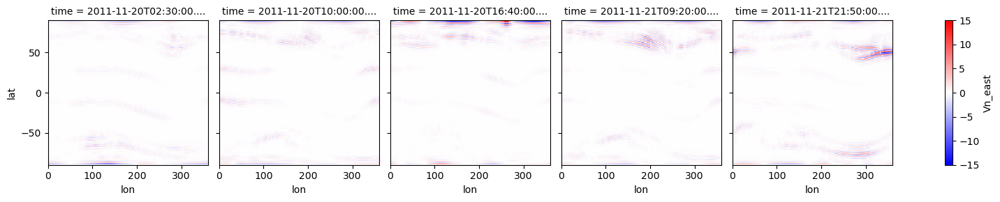

In [158]:
(filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=50, highcut=30, order=3) \
 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')).isel(time=[30,120,200,400,550]).T.\
plot(col='time', vmin=-15, vmax=15, cmap='bwr')

In [192]:
plt.close('all')
gc.collect()

455824

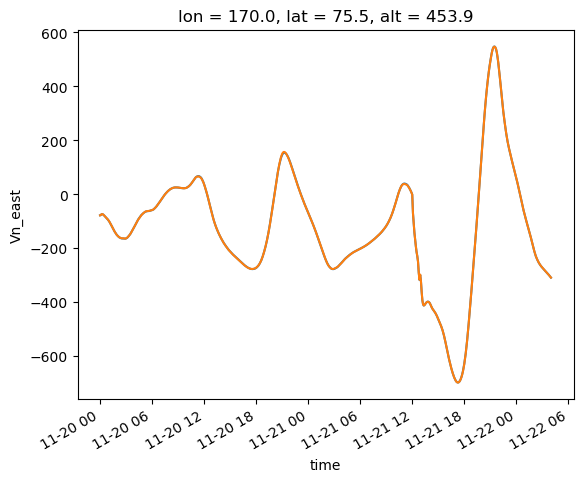

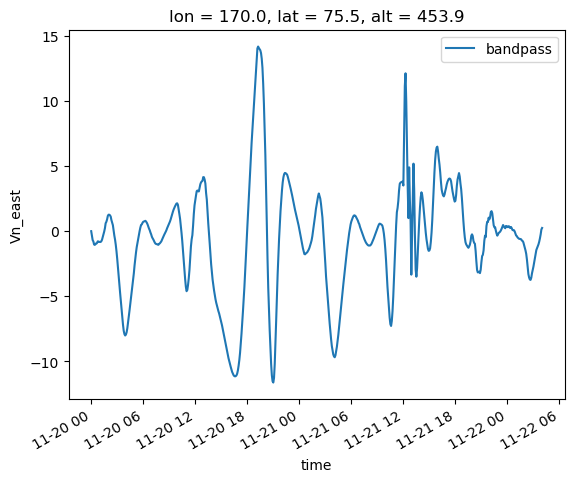

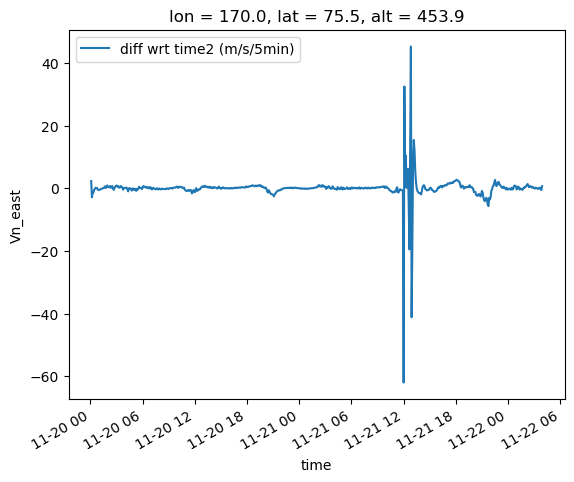

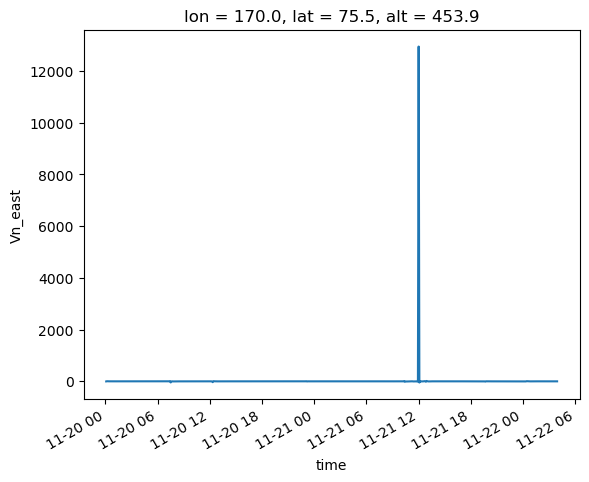

In [193]:

filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=50, highcut=30, order=3).sel(lon=170, lat=75, method='nearest').plot()

# gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time').sel(lon=170, lat=75, method='nearest').plot()

gitms['bz17'].Vn_east.sel(alt=450, method='nearest').sel(lon=170, lat=75, method='nearest').plot()

plt.show()

(filters.make_fits(gitms['bz17'].Vn_east.sel(alt=450, method='nearest'), lowcut=90, highcut=40, order=3) \
 - gitms['bz17'].Vn_east.sel(alt=450, method='nearest')).sel(lon=170, lat=75, method='nearest').plot(label='bandpass')
plt.legend()
plt.show()

gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2, label='lower').sel(lon=170, lat=75, method='nearest').plot(label='diff wrt time2 (m/s/5min)')

plt.legend()
plt.show()

(100*(gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Vn_east.sel(alt=450, method='nearest'))).sel(lon=170, lat=75, method='nearest').plot(label='diff wrt time2 (m/s/5min)')
# plt.legend()
# plt.show()


[170, 75, 450]


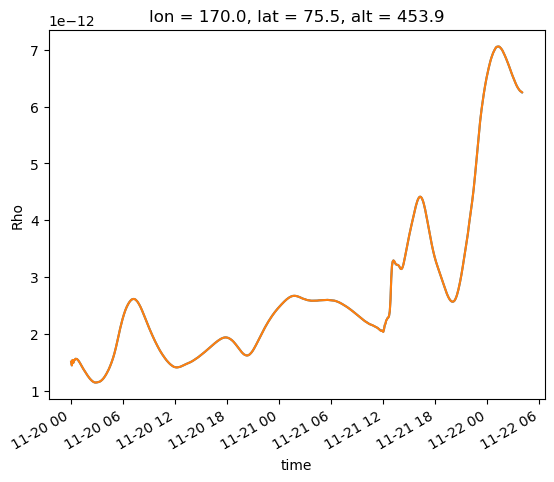

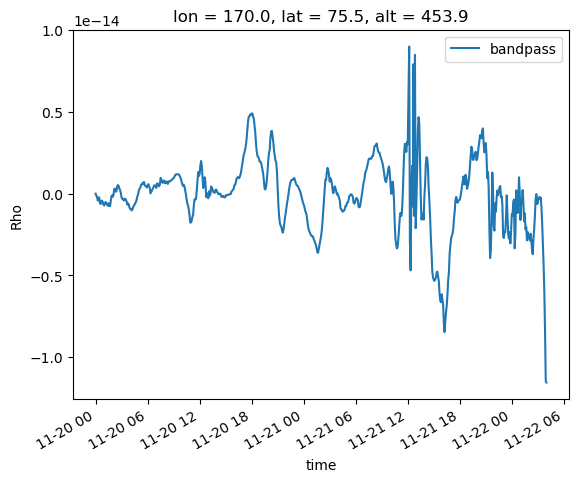

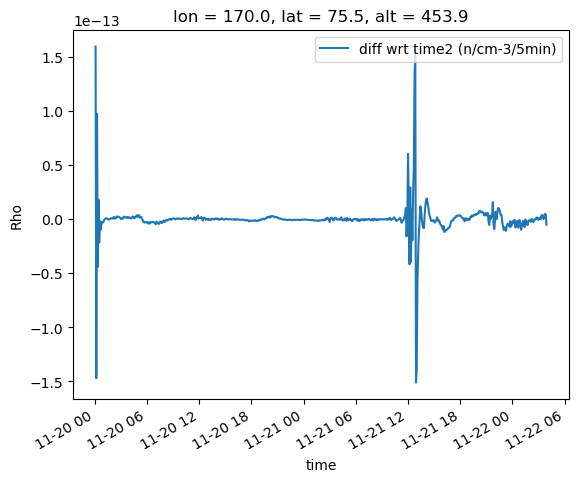

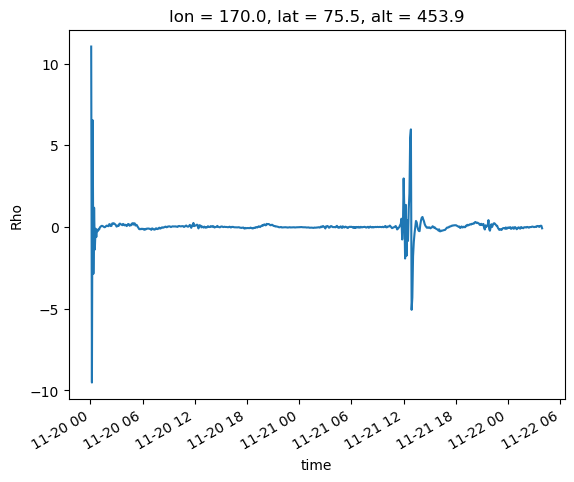



[170, 55, 450]


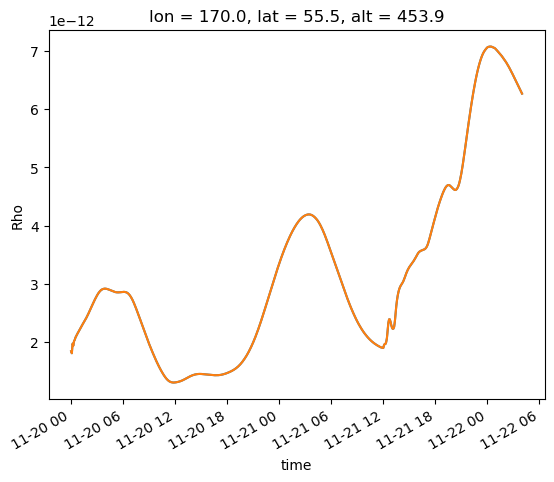

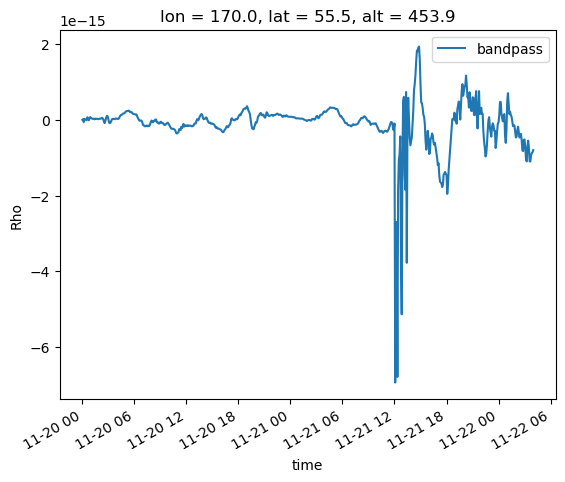

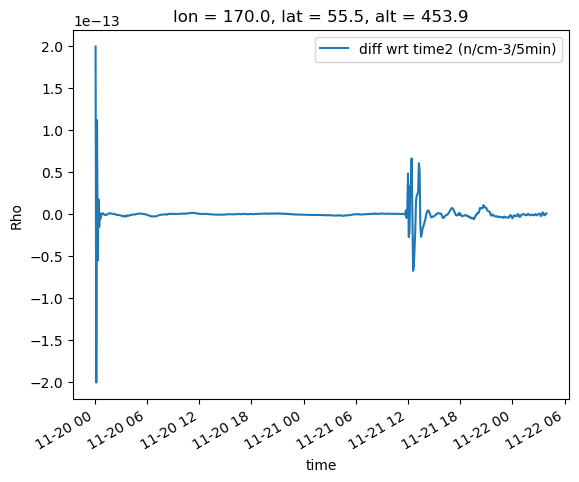

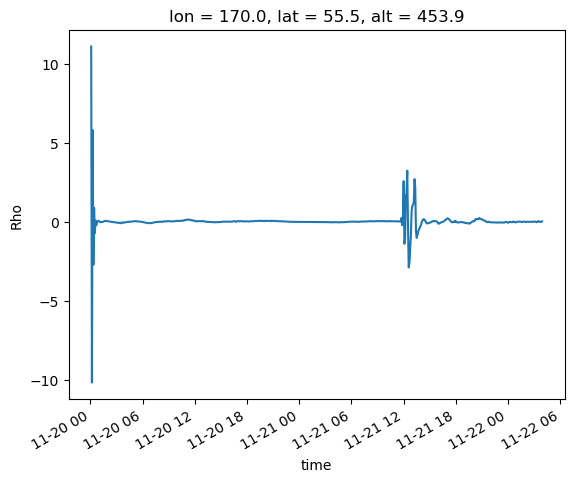



[170, 30, 450]


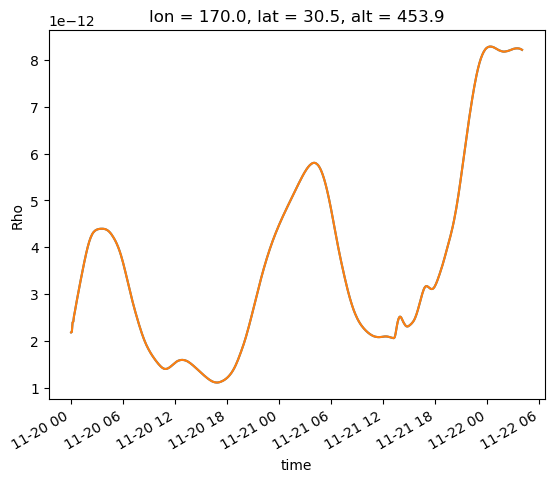

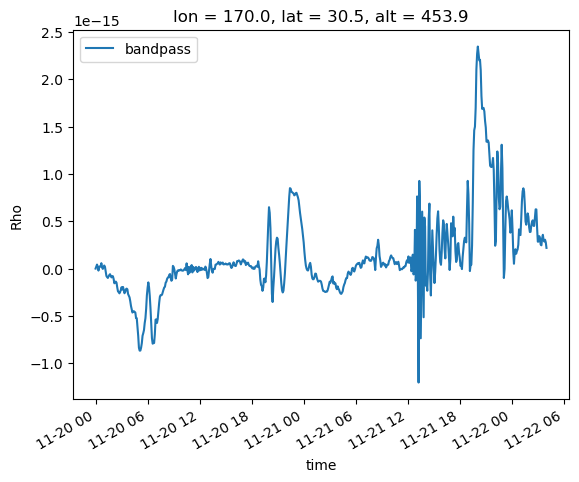

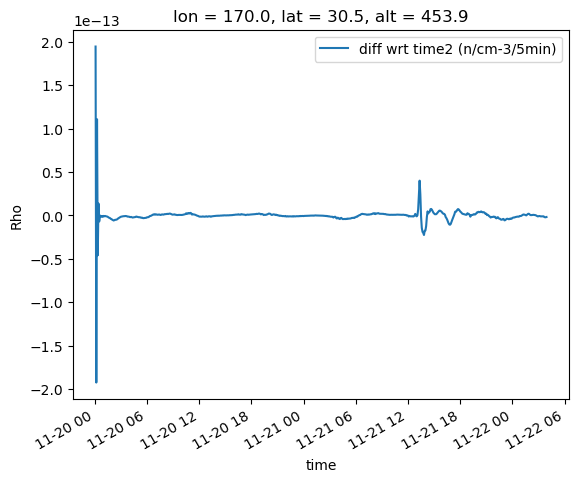

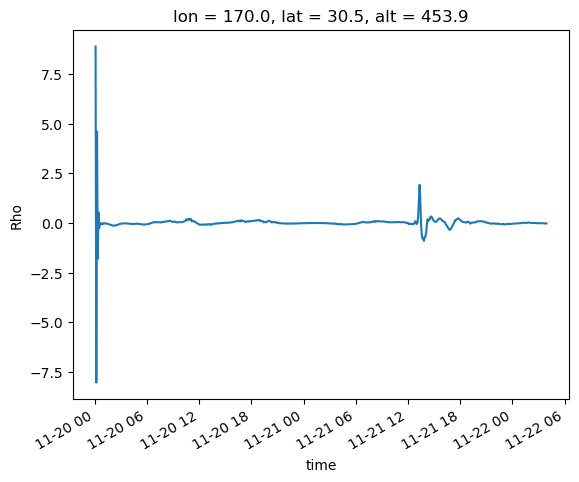



[170, 15, 450]


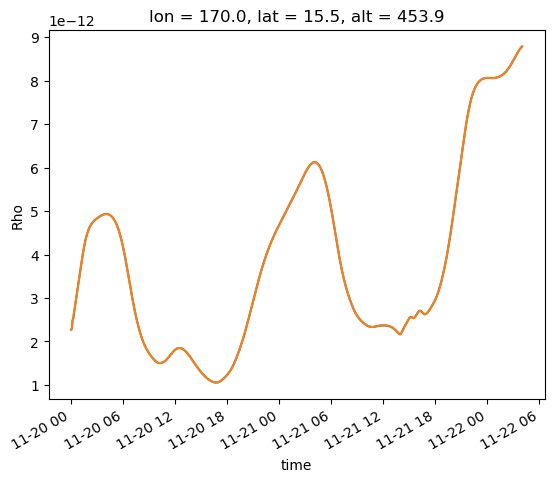

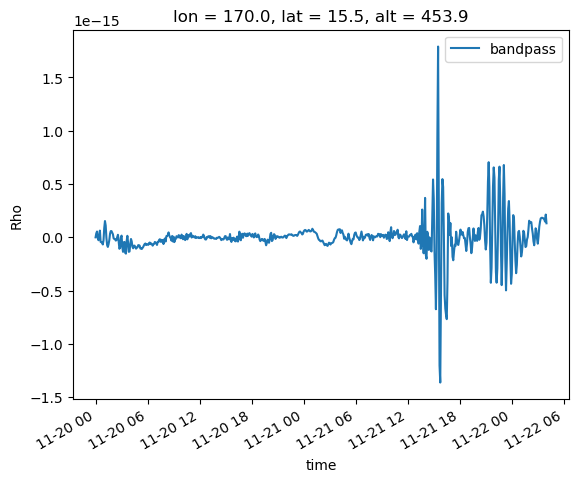

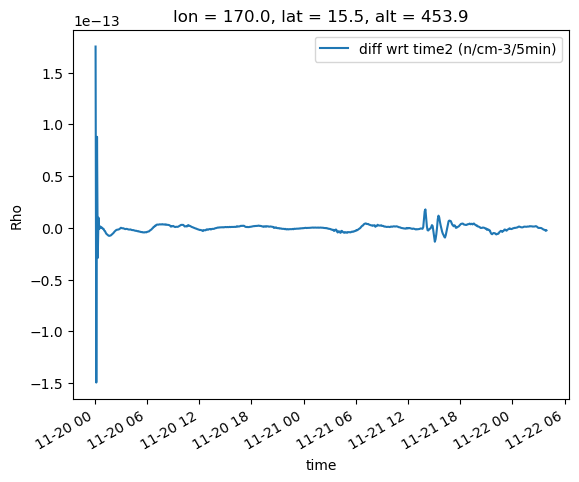

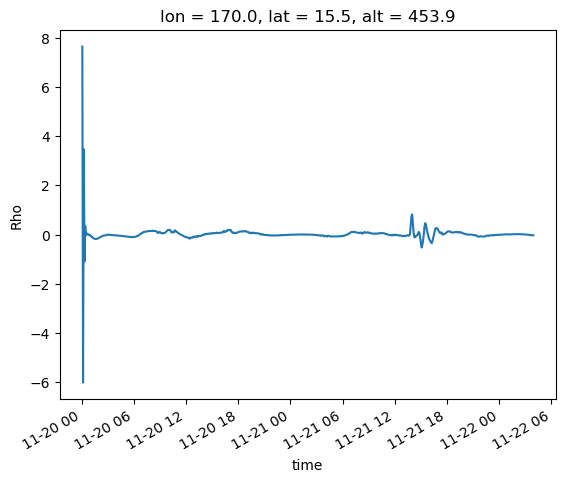



[170, 0, 450]


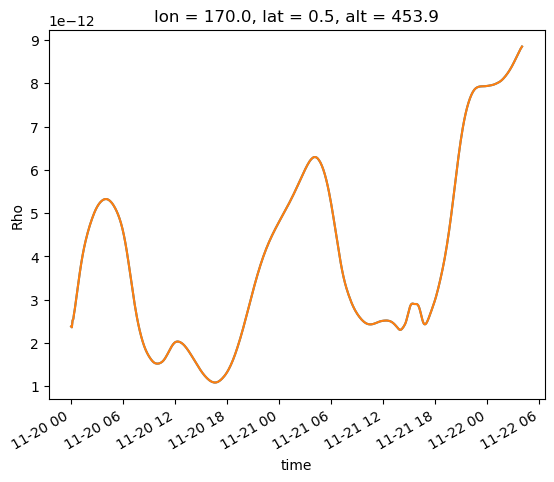

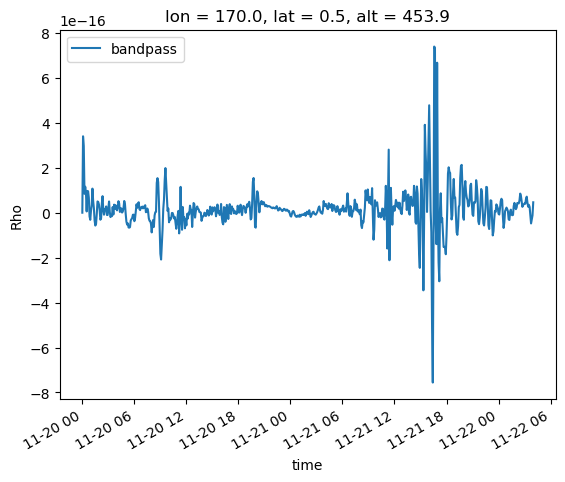

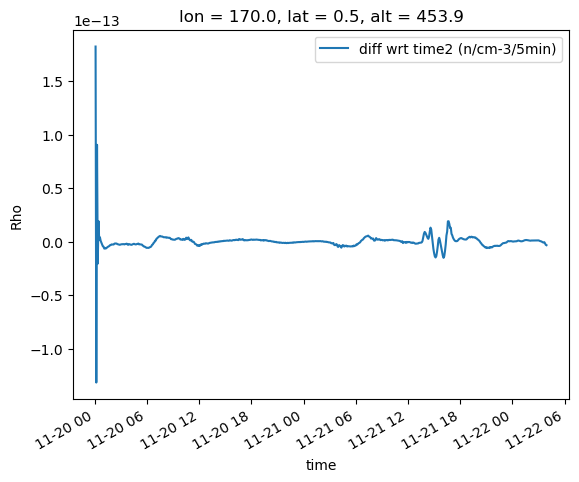

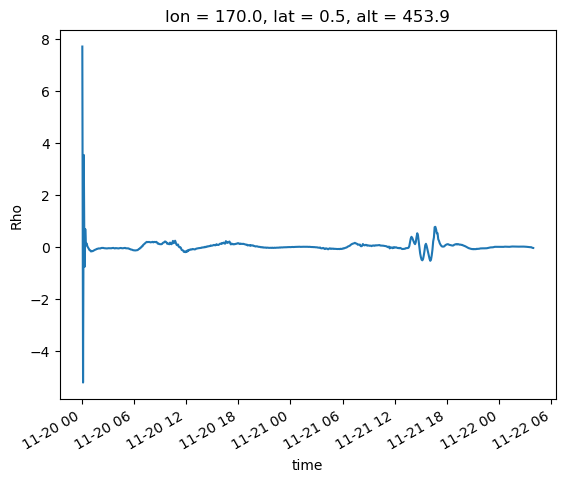

In [274]:
lonlatalt = [[170,75,450],
             [170,55,450],
             [170,30,450],
             [170,15,450],
             [170,0,450]]


for pt in lonlatalt:
    print(pt)

    filters.make_fits(gitms['bz17'].Rho.sel(alt=pt[2], method='nearest'), lowcut=50, highcut=30, order=3).sel(lon=pt[0], lat=pt[1], method='nearest').plot()

    # gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time').sel(lon=170, lat=75, method='nearest').plot()

    gitms['bz17'].Rho.sel(alt=pt[2], method='nearest').sel(lon=pt[0], lat=pt[1], method='nearest').plot()

    plt.show()

    (filters.make_fits(gitms['bz17'].Rho.sel(alt=450, method='nearest'), lowcut=90, highcut=40, order=3) \
     - gitms['bz17'].Rho.sel(alt=pt[2], method='nearest')).sel(lon=pt[0], lat=pt[1], method='nearest').plot(label='bandpass')
    plt.legend()
    plt.show()

    gitms['bz17'].Rho.sel(alt=pt[2], method='nearest').diff('time',2, label='lower').sel(lon=pt[0], lat=pt[1], method='nearest').plot(label='diff wrt time2 (n/cm-3/5min)')

    plt.legend()
    plt.show()

    (100*(gitms['bz17'].Rho.sel(alt=pt[2], method='nearest').diff('time',2, label='lower')/gitms['bz17'].Rho.sel(alt=pt[2], method='nearest')).sel(lon=pt[0], lat=pt[1], method='nearest')).plot(label='%diff wrt time')
    
    plt.show()
    print('\n')

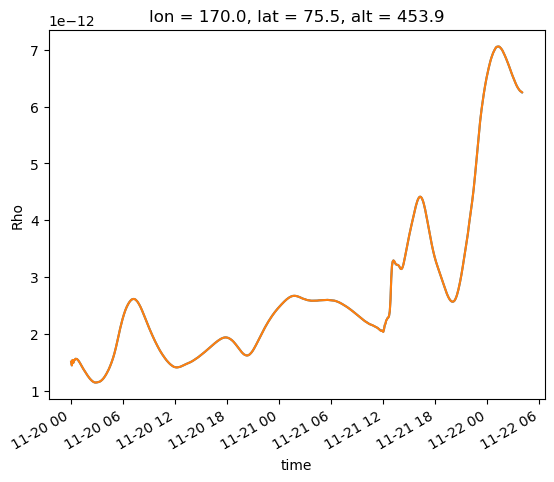

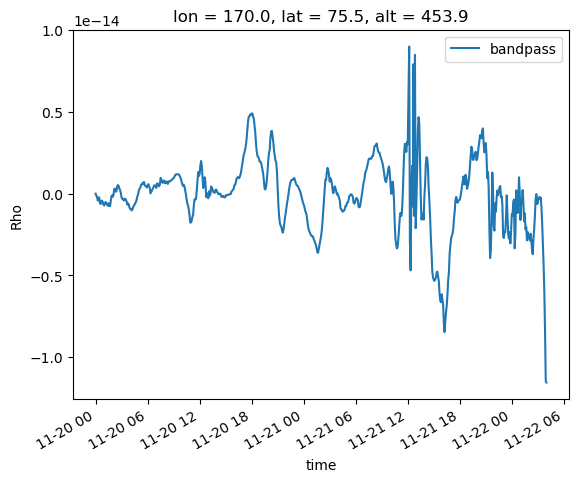

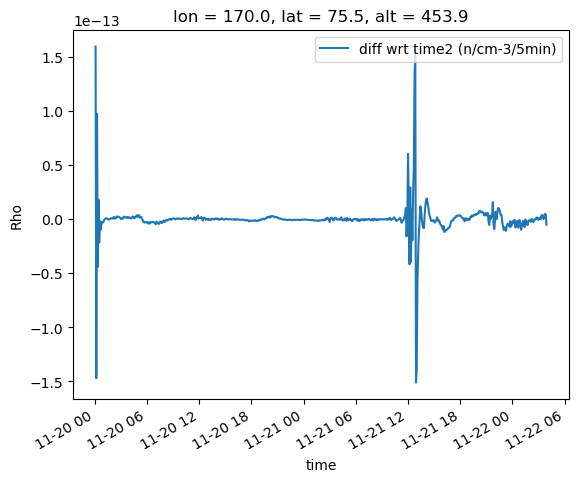

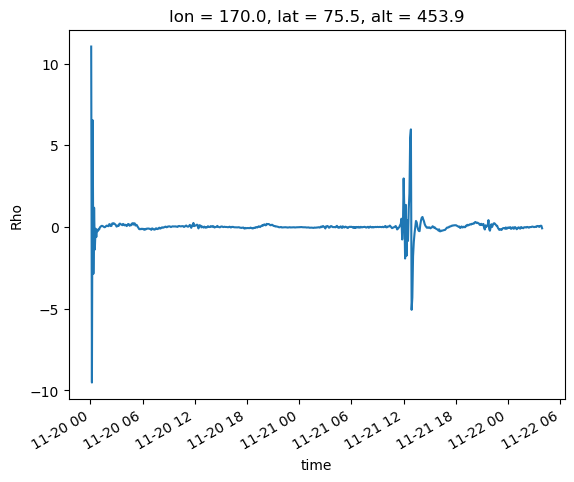

In [189]:
filters.make_fits(gitms['bz17'].Rho.sel(alt=450, method='nearest'), lowcut=50, highcut=30, order=3).sel(lon=170, lat=75, method='nearest').plot()

# gitms['bz17'].Vn_east.sel(alt=450, method='nearest').diff('time').sel(lon=170, lat=75, method='nearest').plot()

gitms['bz17'].Rho.sel(alt=450, method='nearest').sel(lon=170, lat=75, method='nearest').plot()

plt.show()

(filters.make_fits(gitms['bz17'].Rho.sel(alt=450, method='nearest'), lowcut=90, highcut=40, order=3) \
 - gitms['bz17'].Rho.sel(alt=450, method='nearest')).sel(lon=170, lat=75, method='nearest').plot(label='bandpass')
plt.legend()
plt.show()

gitms['bz17'].Rho.sel(alt=450, method='nearest').diff('time',2, label='lower').sel(lon=170, lat=75, method='nearest').plot(label='diff wrt time2 (n/cm-3/5min)')

plt.legend()
plt.show()

(100*(gitms['bz17'].Rho.sel(alt=450, method='nearest').diff('time',2, label='lower')/gitms['bz17'].Rho.sel(alt=450, method='nearest')).sel(lon=170, lat=75, method='nearest')).plot(label='%diff wrt time')

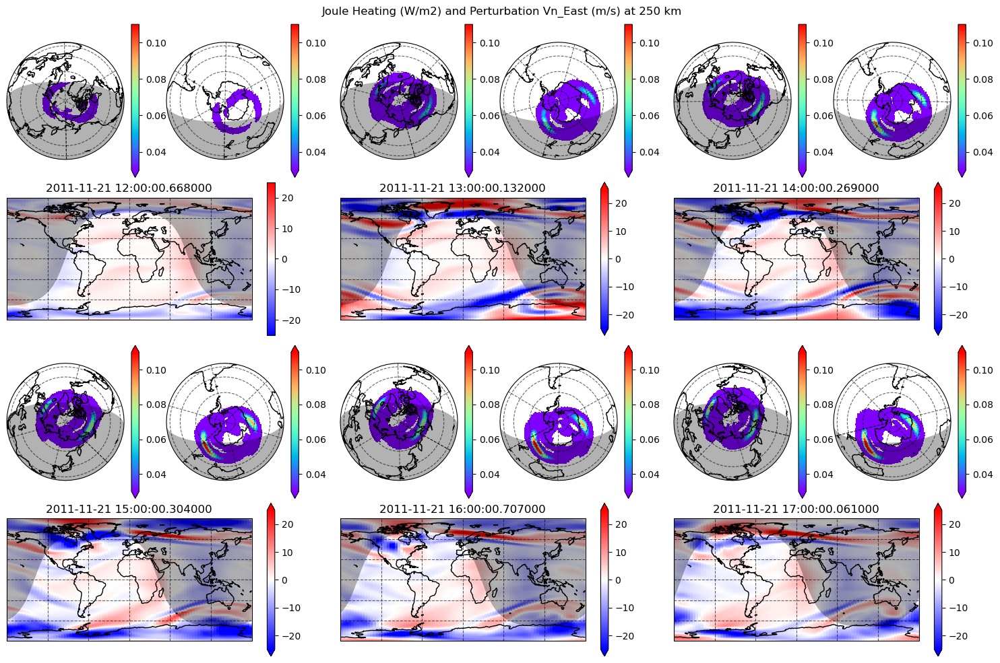

In [263]:
fig = plotting_routines.map_and_dials(dial_da=gitms['bz17'].AltIntJouleHeating_W_m2,
                                    total=6,
                                    map_da=gitms['bz17'].Vn_east.sel(
                                            alt=250, method='nearest').diff('time',),
                                    max_per_row=3, mask_dials=0.002,
                                    suptitle='Joule Heating (W/m2) and Perturbation Vn_East (m/s) at 250 km',
                                    time_start='2011-11-21 12:00',
                                    map_cmap='bwr', vmin_dial=0.03, vmax_dial=.11, vmin_map=-25, vmax_map=25)



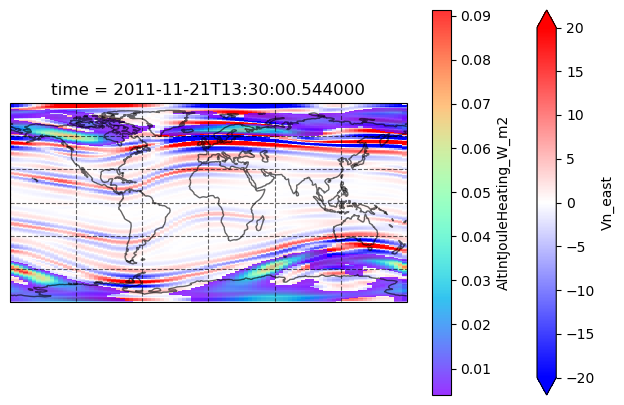

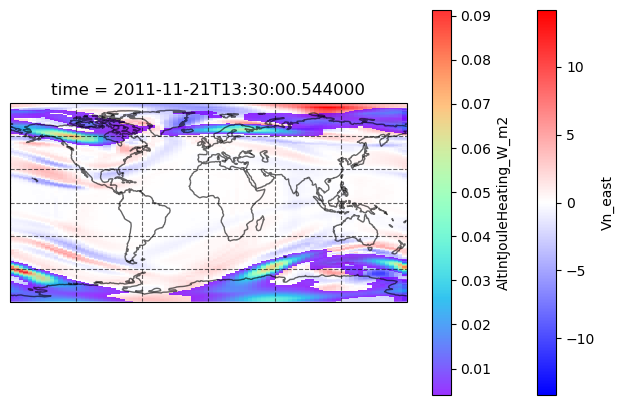

In [269]:
a = filters.make_fits(gitms['bz17'].Vn_east.sel(alt=350, method='nearest'), lowcut=140, highcut=45).sel(time='2011-11-21 13:30', method='nearest')

b=gitms['bz17'].Vn_east.sel(alt=350, method='nearest').sel(time='2011-11-21 13:30', method='nearest')



fig = plt.figure(figsize=(8,5))
ax = fig.add_subplot(projection=ccrs.PlateCarree())


(a-b).plot(transform=ccrs.PlateCarree(), x='lon', ax=ax, vmin=-20, vmax=20, cmap='bwr')

gitms['bz17'].AltIntJouleHeating_W_m2.where(gitms['bz17'].AltIntJouleHeating_W_m2 > 0.004).sel(time='2011-11-21 13:30', method='nearest').plot(cmap='rainbow', transform=ccrs.PlateCarree(), ax=ax, x='lon', alpha=0.8)


ax.coastlines(color='black', alpha=.6)
ax.gridlines(color='black', linestyle='--', alpha=0.6)
plt.show()
plt.close('all')


########    ~~~~~~~~~~~       ###############


a = filters.filter_xarray_DA_diff(gitms['bz17'].Vn_east.sel(alt=350, method='nearest')).sel(time='2011-11-21 13:30', method='nearest')

b=gitms['bz17'].Vn_east.sel(alt=350, method='nearest').sel(time='2011-11-21 13:30', method='nearest')


fig = plt.figure(figsize=(8,5))
ax = fig.add_subplot(projection=ccrs.PlateCarree())


(a).plot(transform=ccrs.PlateCarree(), x='lon', ax=ax, cmap='bwr')

gitms['bz17'].AltIntJouleHeating_W_m2.where(gitms['bz17'].AltIntJouleHeating_W_m2 > 0.004).sel(time='2011-11-21 13:30', method='nearest').plot(cmap='rainbow', transform=ccrs.PlateCarree(), ax=ax, x='lon', alpha=0.8)


ax.coastlines(color='black', alpha=.6)
ax.gridlines(color='black', linestyle='--', alpha=0.6)
plt.show()
plt.close('all')

In [218]:
filters = importlib.reload(filters)

In [69]:
plotting_routines = importlib.reload(plotting_routines)

/glade/u/home/abukowski/SAMI3-GITM-python/utility_programs/plotting_routines.py:13: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = geopandas.read_file(geopandas.datasets.get_path("naturalearth_lowres"))
